In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import glob
import random

import pandas as pd
import numpy as np
import cv2
from tqdm import tqdm_notebook as tqdm

import torch
import torch.nn as nn
import torchvision
from torchvision.transforms import functional as F

import matplotlib.pyplot as plt

In [8]:
def get_profile_path(category):

    data = []

    for path in sorted(glob.glob('D:/FYP/Dataset/%s/*.jpg' % category)):
        #path=re.sub(r" ?\([^)]+\)","",path)
        
        
        label=str(path.split('/')[-1].split('.')[0]).replace(category,'')[1:]
        label = ''.join(i for i in label if not i.isdigit())

        data.append({
            'path': path,
            'label': label ,
        })
            
    return pd.DataFrame(data)

train = get_profile_path('train')
test = get_profile_path('test')

In [9]:
def get_profile_path():

    data = []

    for path in sorted(glob.glob('C:/Users/Varadharajan R/Desktop/FYP/Dataset/*.jpg')):
        label=str(path.split('/')[-1].split('.')[0]).replace('Dataset','')[1:]
        label = ''.join(i for i in label if not i.isdigit() and i!='(' and i!=')')

        data.append({
            'path': path,
            'label': label ,
        })
            
    return pd.DataFrame(data)

df = get_profile_path()

In [10]:
df

,path,label
0,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ab...,abies_concolor
1,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ab...,abies_concolor
2,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ab...,abies_concolor
3,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ab...,abies_concolor
4,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ab...,abies_concolor
...,...,...
7714,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ze...,zelkova_serrata
7715,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ze...,zelkova_serrata
7716,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ze...,zelkova_serrata
7717,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ze...,zelkova_serrata


In [46]:
#train and test split
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.2)

In [54]:
train

,path,label
0,C:/Users/Varadharajan R/Desktop/FYP/Dataset\cr...,cryptomeria_japonica
1,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...,quercus_stellata
2,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...,quercus_velutina
3,C:/Users/Varadharajan R/Desktop/FYP/Dataset\sy...,syringa_reticulata
4,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pi...,pinus_strobus
...,...,...
6170,C:/Users/Varadharajan R/Desktop/FYP/Dataset\gl...,gleditsia_triacanthos
6171,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pr...,prunus_sargentii
6172,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...,quercus_macrocarpa
6173,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pi...,pinus_cembra


In [53]:
test

,path,label
0,C:/Users/Varadharajan R/Desktop/FYP/Dataset\st...,stewartia_pseudocamellia
1,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ac...,acer_palmatum
2,C:/Users/Varadharajan R/Desktop/FYP/Dataset\cr...,crataegus_viridis
3,C:/Users/Varadharajan R/Desktop/FYP/Dataset\po...,populus_tremuloides
4,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ca...,catalpa_speciosa
...,...,...
1539,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pr...,prunus_sargentii
1540,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ca...,catalpa_speciosa
1541,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ae...,aesculus_pavi
1542,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ts...,tsuga_canadensis


In [52]:
train = train.reset_index(drop=True)
test = test.reset_index(drop=True)

In [74]:
def resize_to_square(image, size):
    h, w, d = image.shape
    ratio = size / max(h, w)
    resized_image = cv2.resize(image, (int(w*ratio), int(h*ratio)), cv2.INTER_AREA)
    return resized_image

def image_to_tensor(image, normalize=None):
    tensor = torch.from_numpy(np.moveaxis(image / (255. if image.dtype == np.uint8 else 1), -1, 0).astype(np.float32))
    if normalize is not None:
        return F.normalize(tensor, **normalize)
    return tensor

def pad(image, min_height, min_width):
    h,w,d = image.shape

    if h < min_height:
        h_pad_top = int((min_height - h) / 2.0)
        h_pad_bottom = min_height - h - h_pad_top
    else:
        h_pad_top = 0
        h_pad_bottom = 0

    if w < min_width:
        w_pad_left = int((min_width - w) / 2.0)
        w_pad_right = min_width - w - w_pad_left
    else:
        w_pad_left = 0
        w_pad_right = 0

    return cv2.copyMakeBorder(image, h_pad_top, h_pad_bottom, w_pad_left, w_pad_right, cv2.BORDER_CONSTANT, value=(0,0,0))


class Dataset(torch.utils.data.Dataset):
    
    def __init__(self, df, size):
        self.df = df
        self.size = size
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):

        row = self.df.iloc[idx]

        image = cv2.imread(row.path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        show_image_pair(image,resize_to_square(image, self.size))
        show_image_pair(image,pad(image, self.size, self.size))
        image = resize_to_square(image, self.size)
        image = pad(image, self.size, self.size)
        tensor = image_to_tensor(image, normalize={'mean': [0.485, 0.456, 0.406], 'std': [0.229, 0.224, 0.225]})
            
        return tensor

In [75]:
random.seed(70)

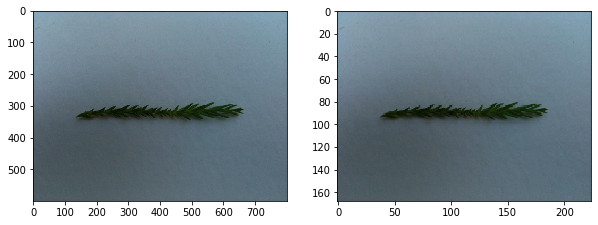

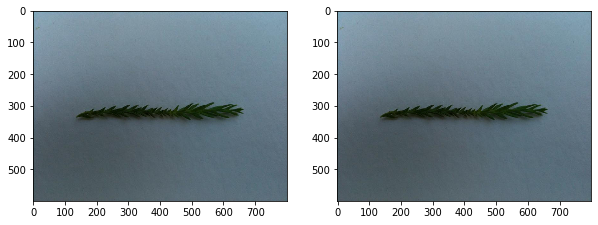

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


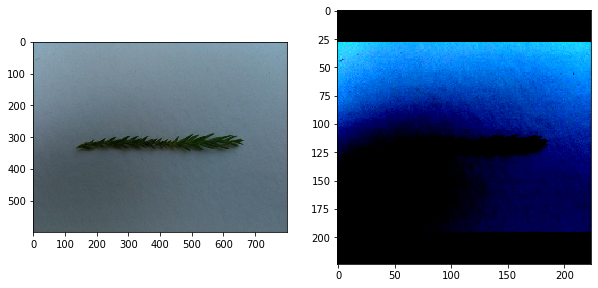

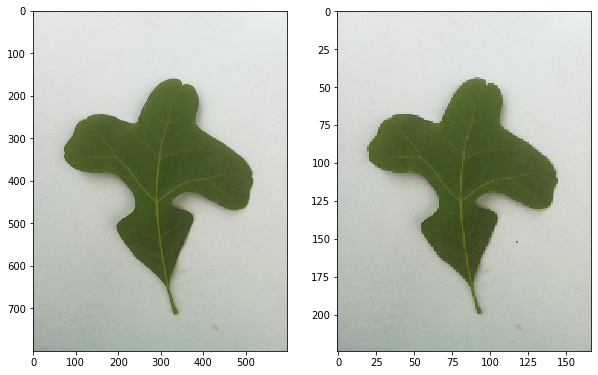

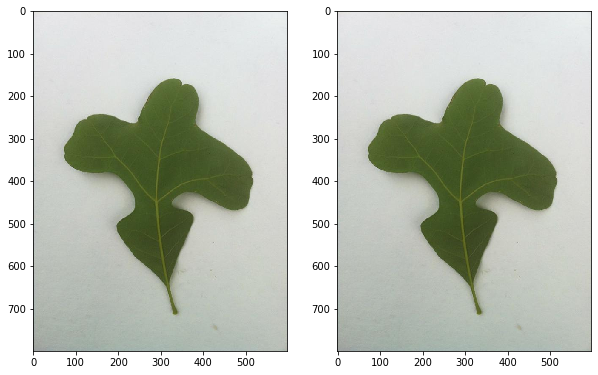

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


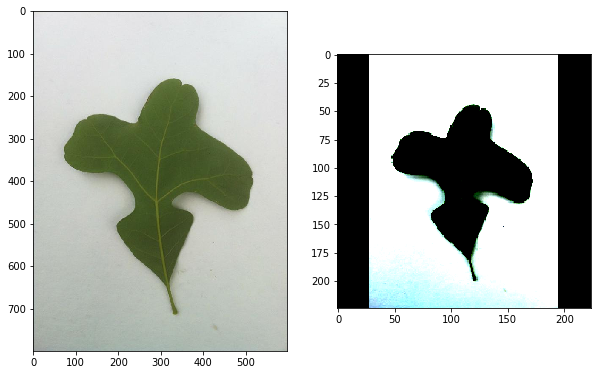

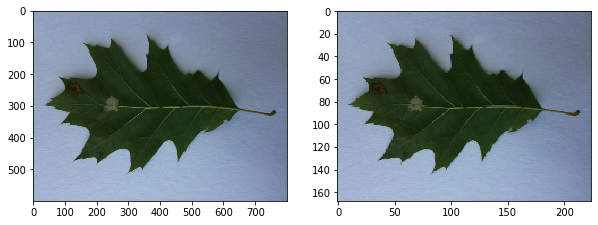

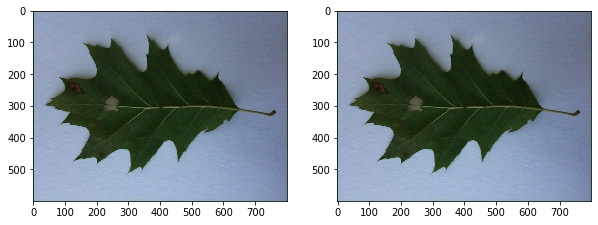

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


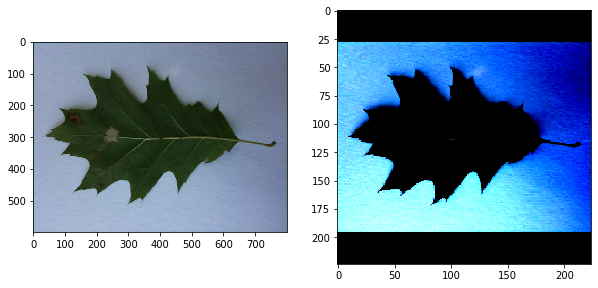

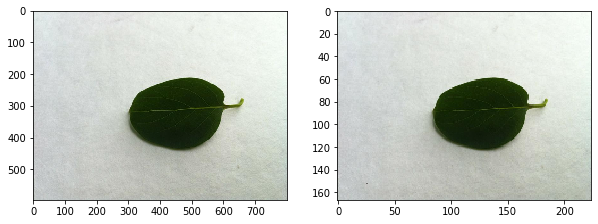

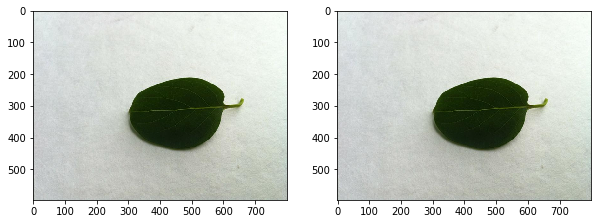

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


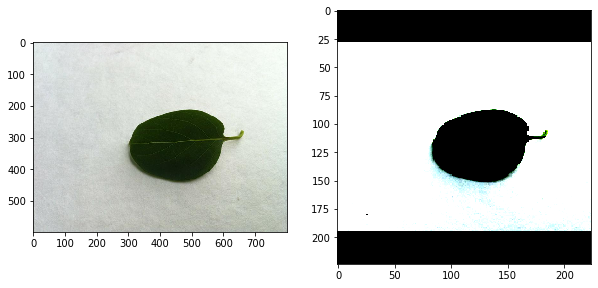

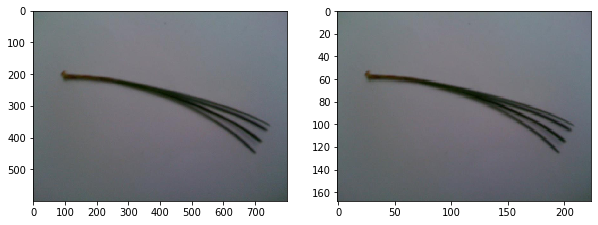

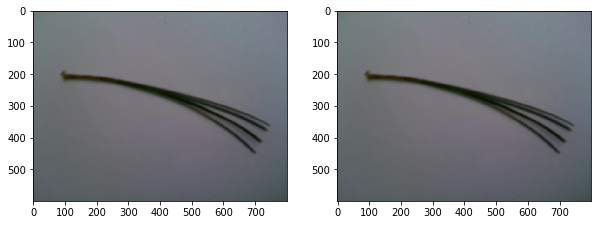

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


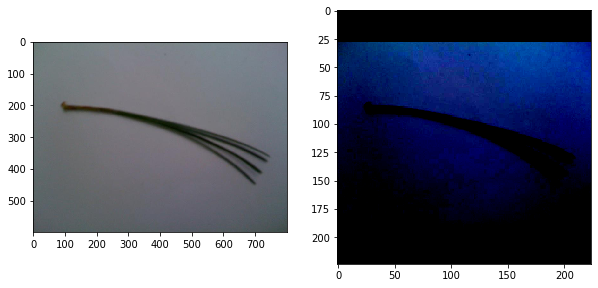

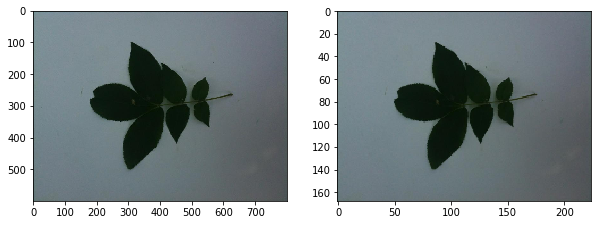

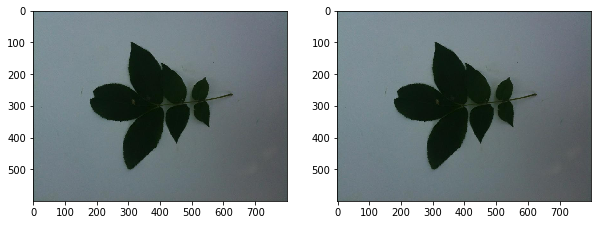

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


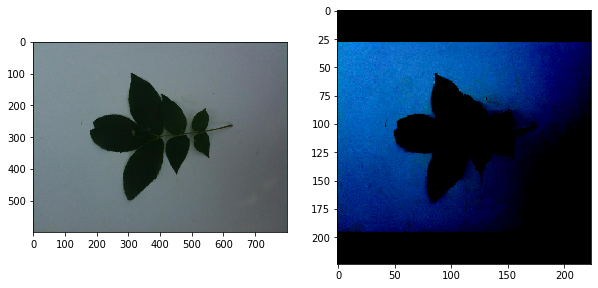

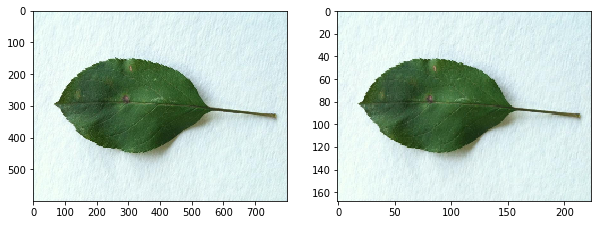

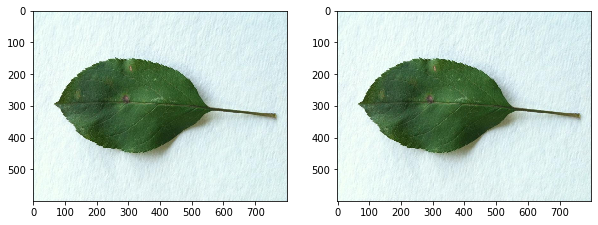

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


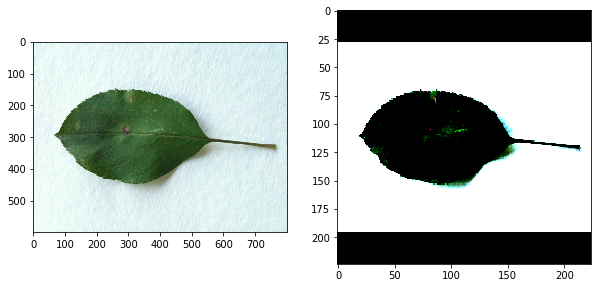

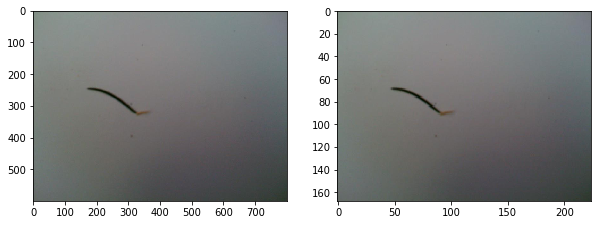

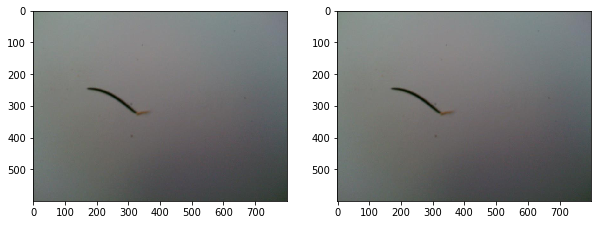

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


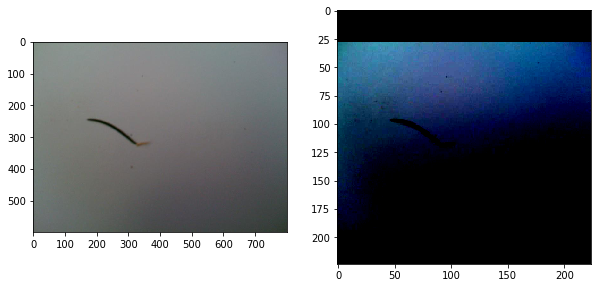

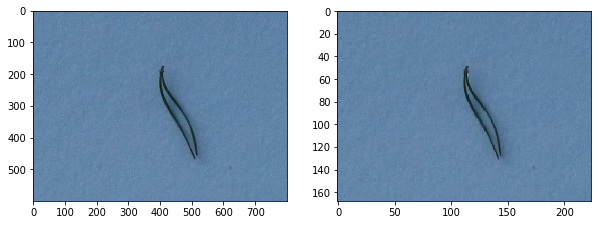

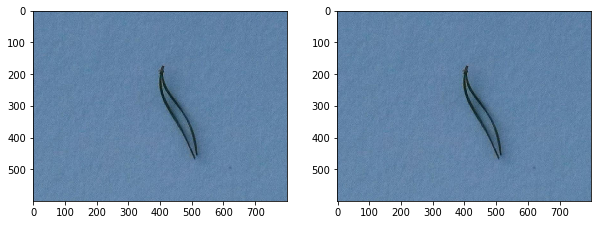

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


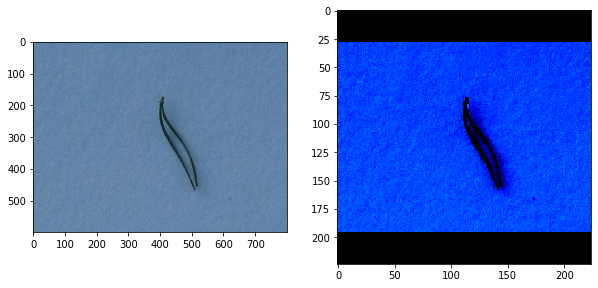

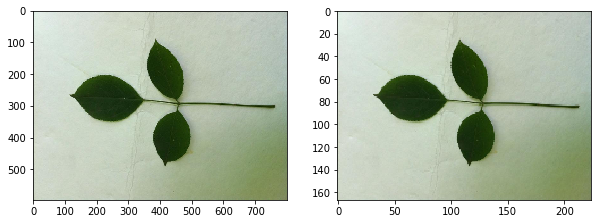

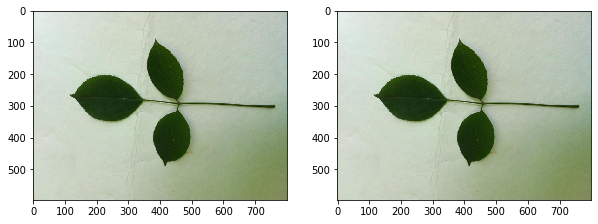

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


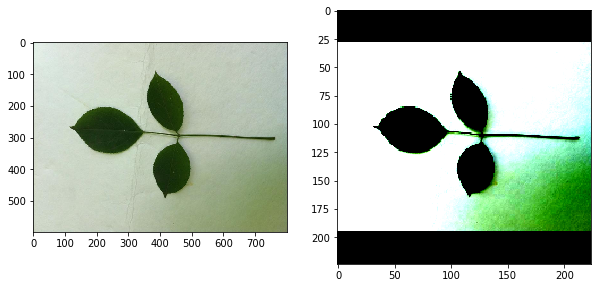

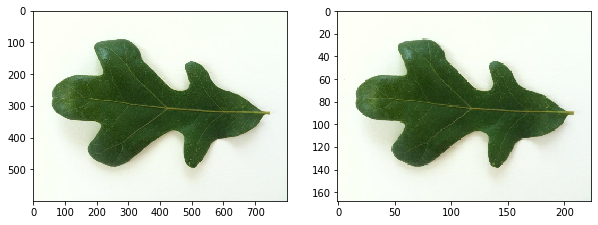

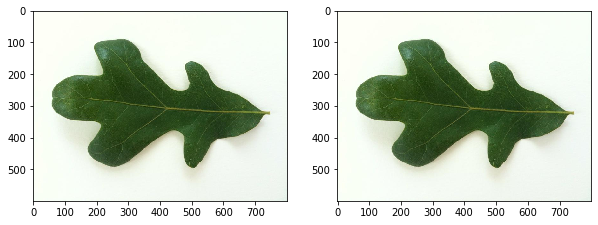

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


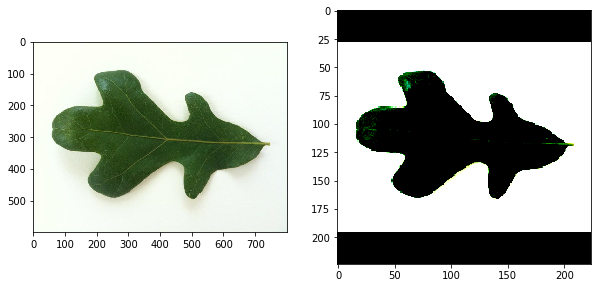

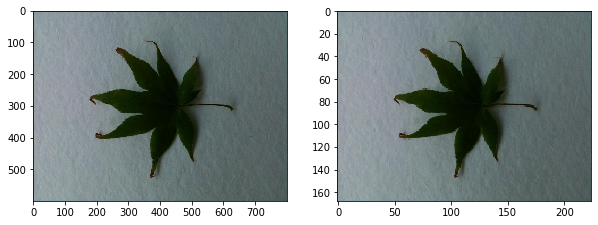

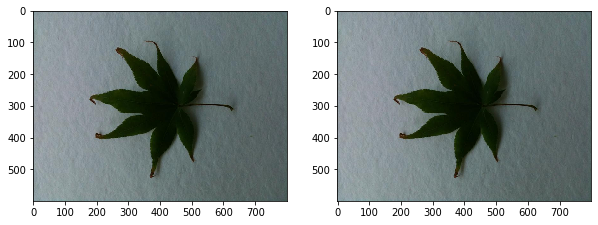

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


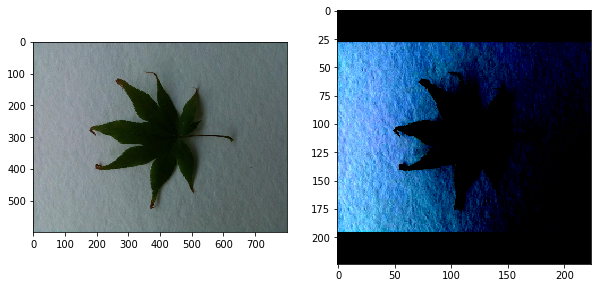

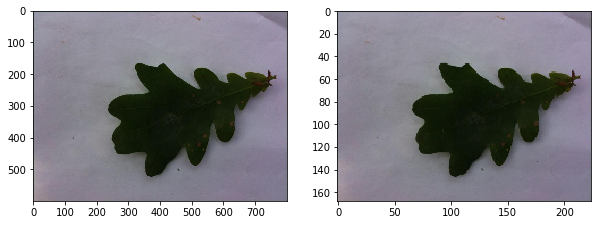

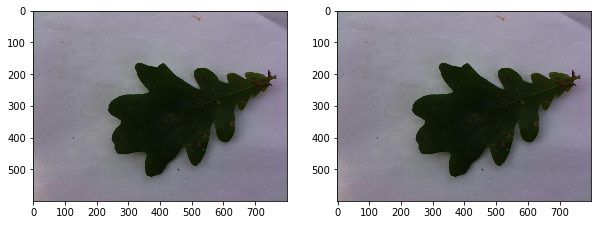

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


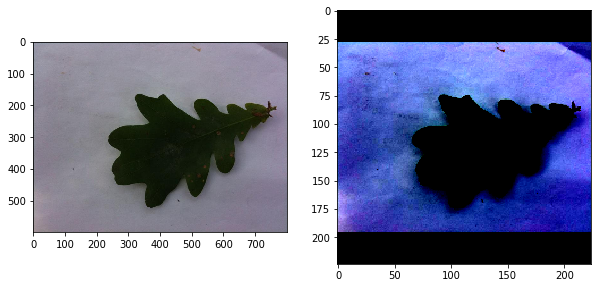

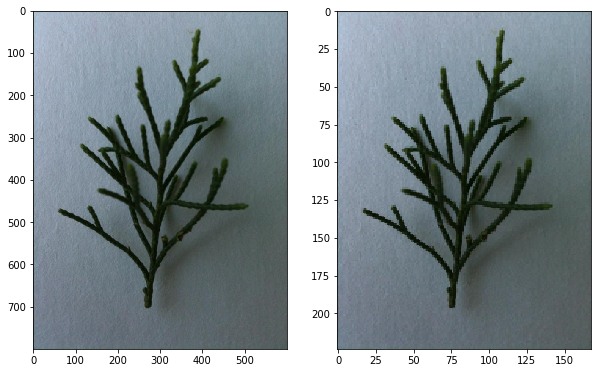

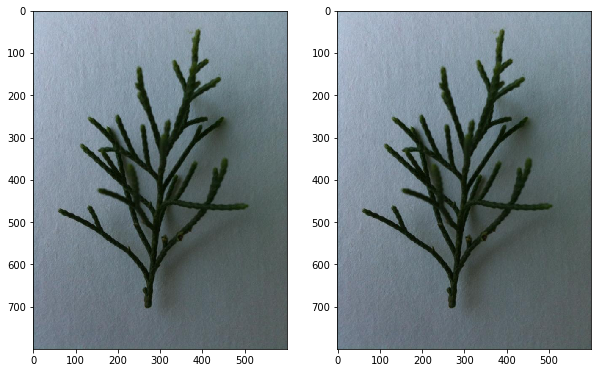

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


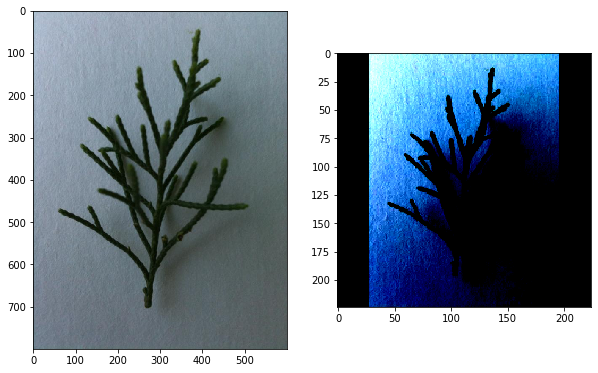

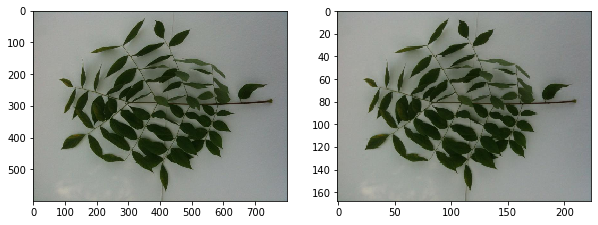

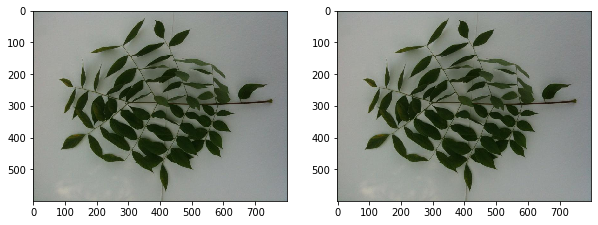

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


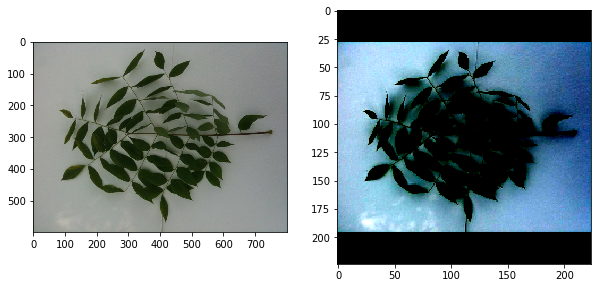

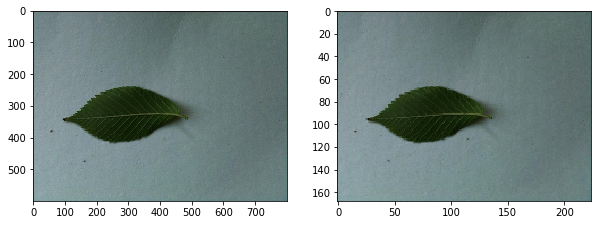

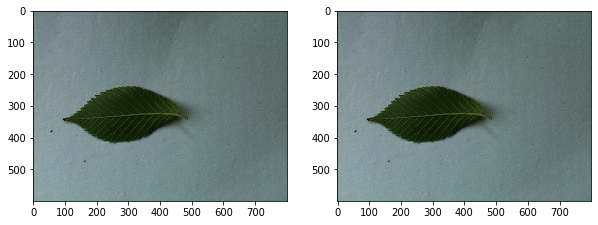

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


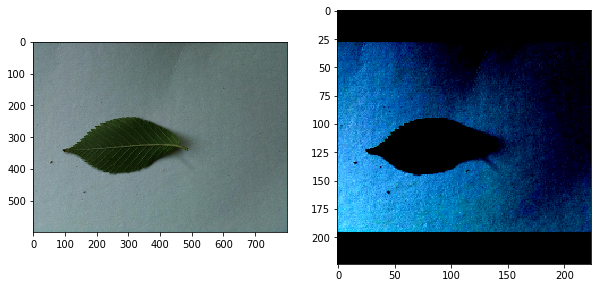

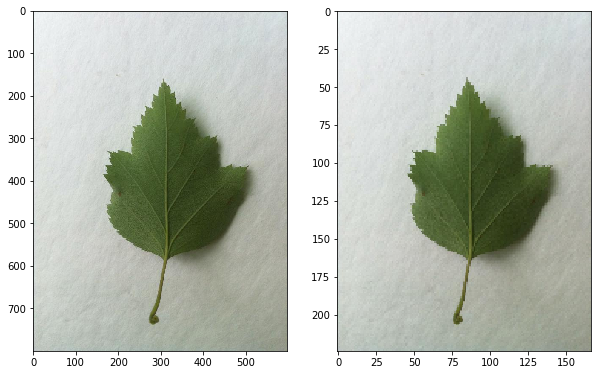

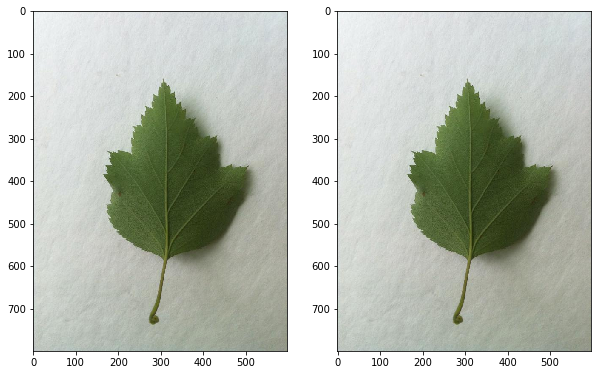

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


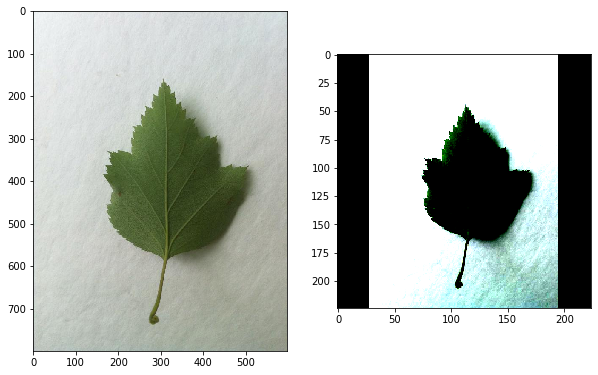

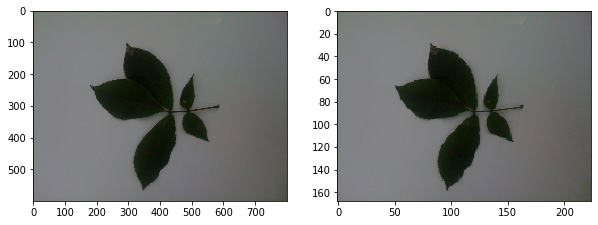

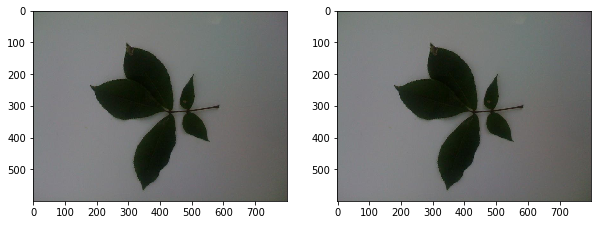

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


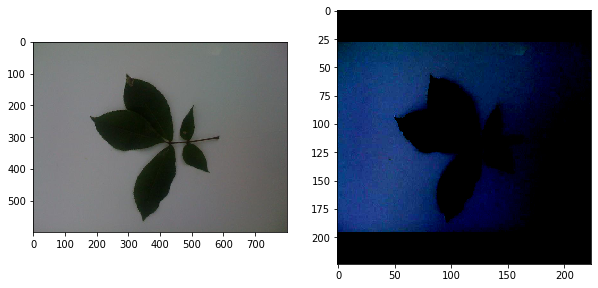

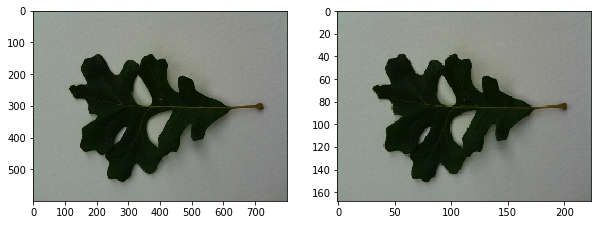

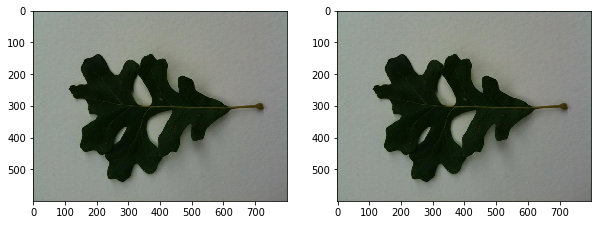

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


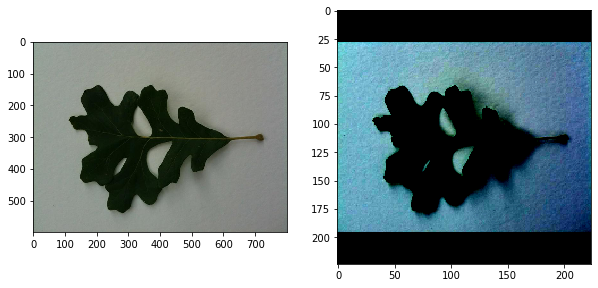

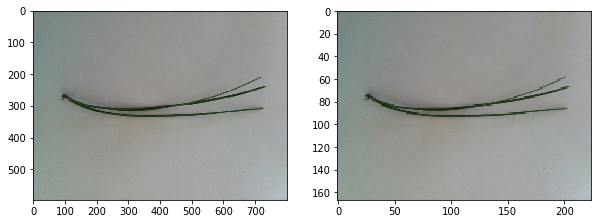

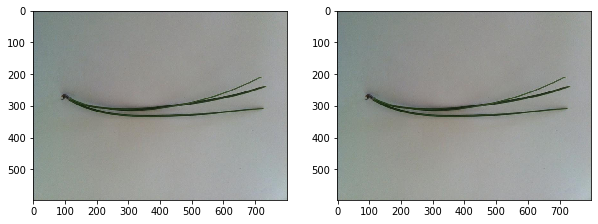

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


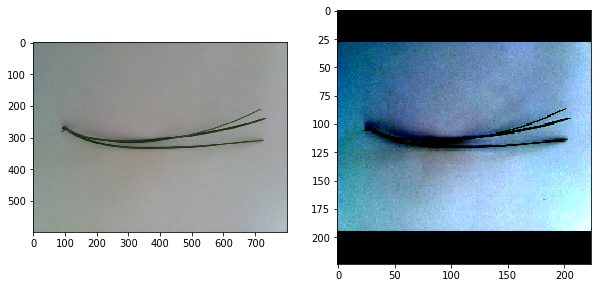

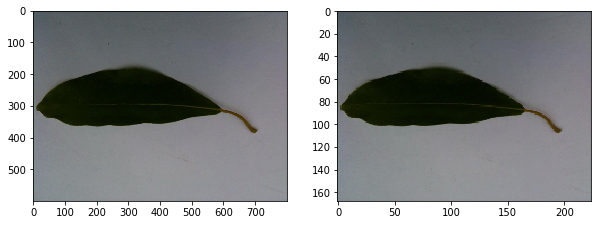

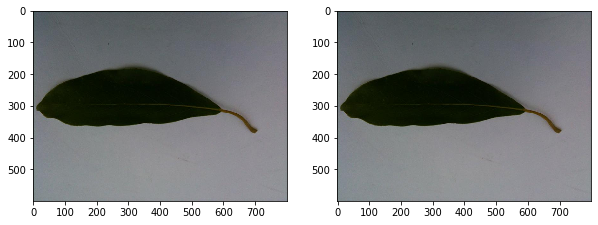

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


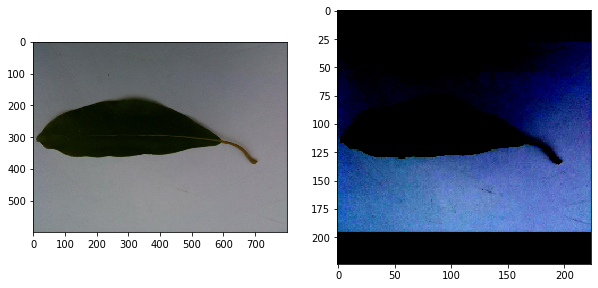

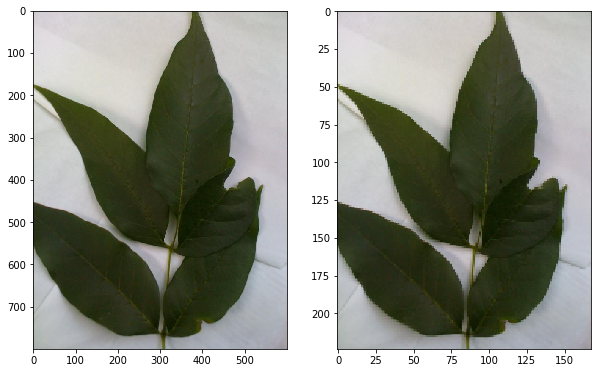

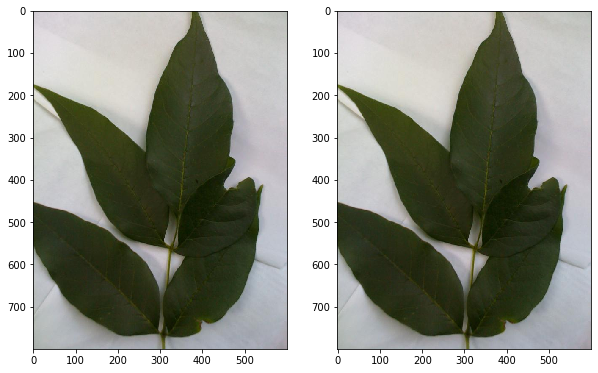

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


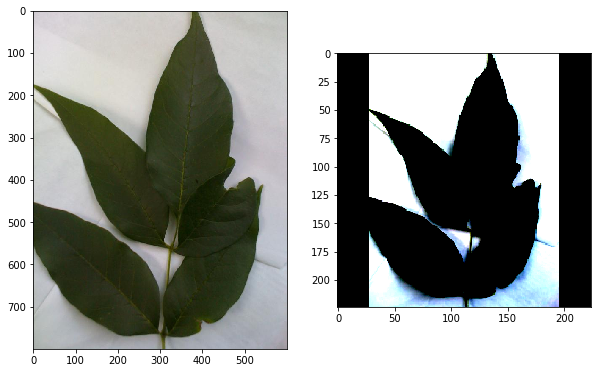

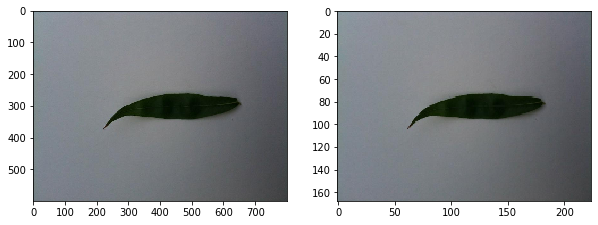

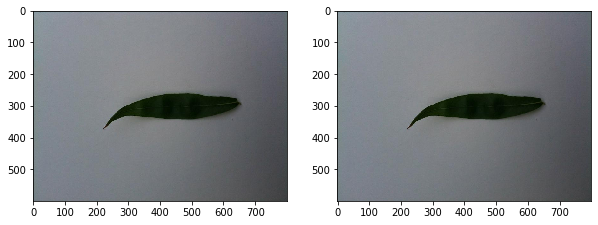

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


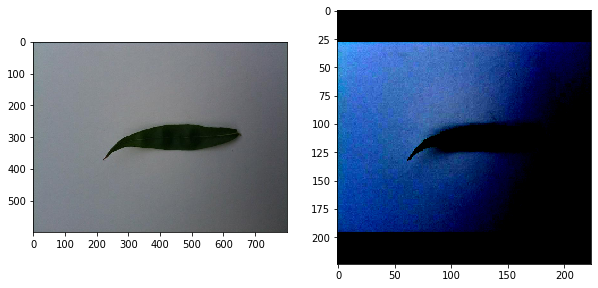

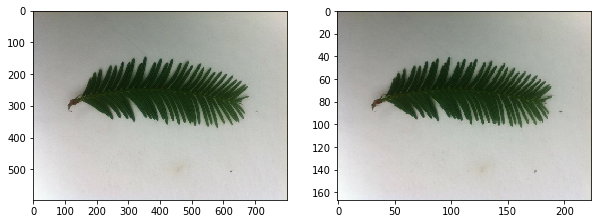

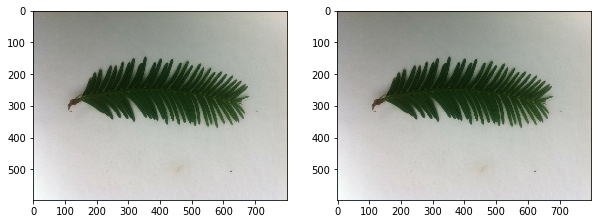

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


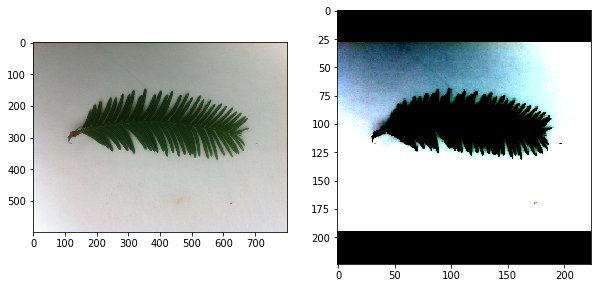

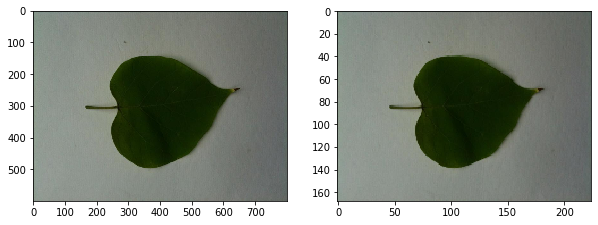

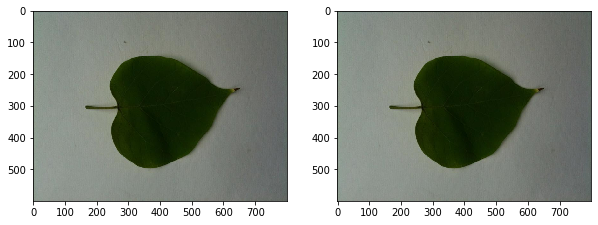

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


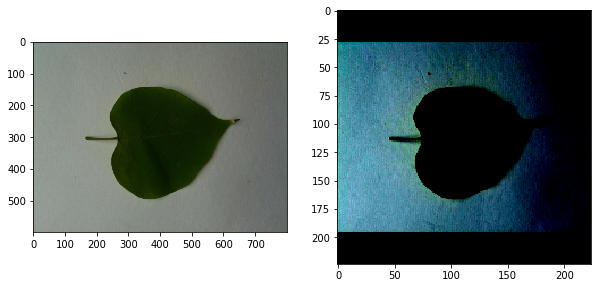

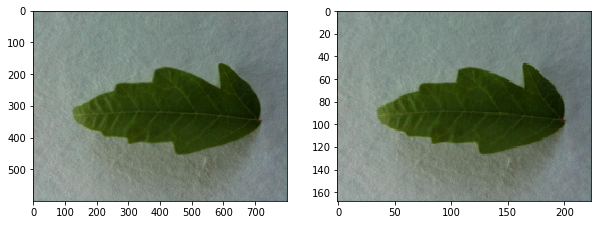

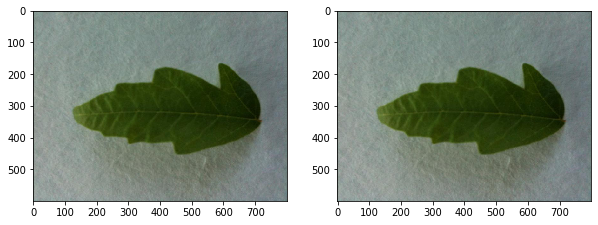

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


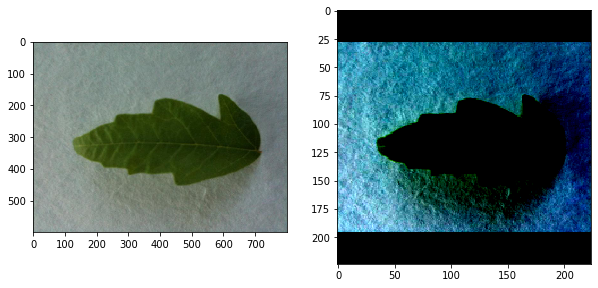

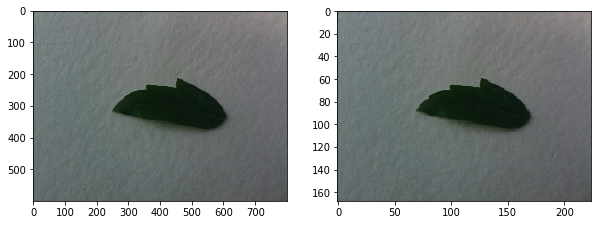

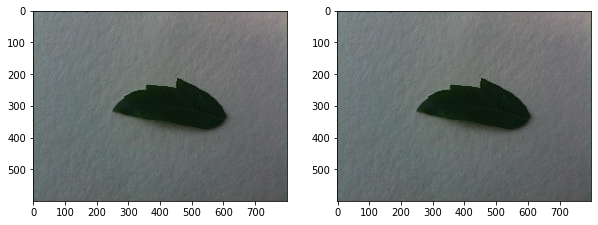

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


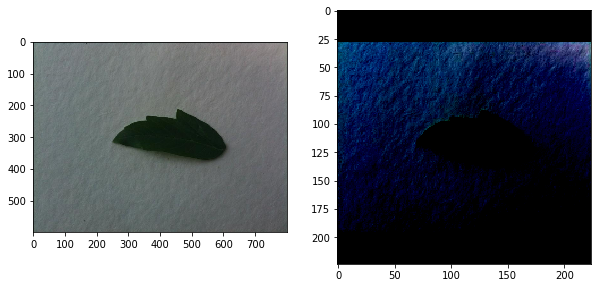

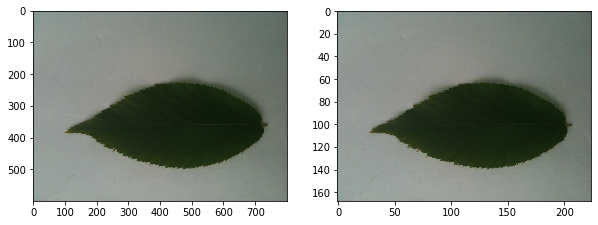

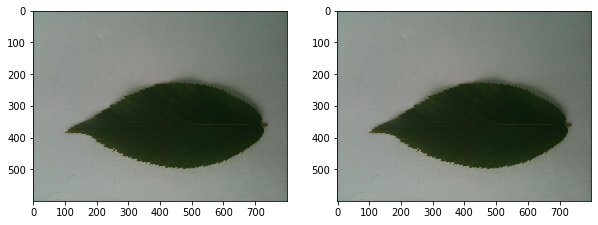

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


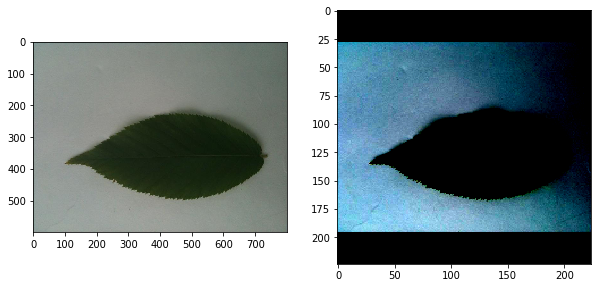

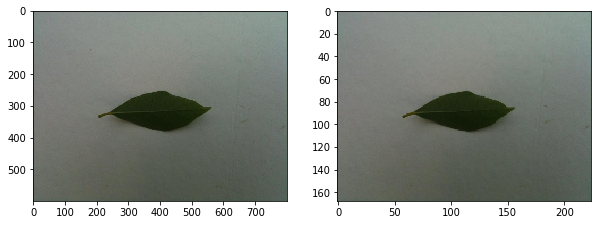

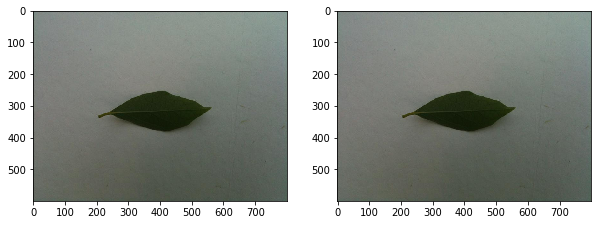

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


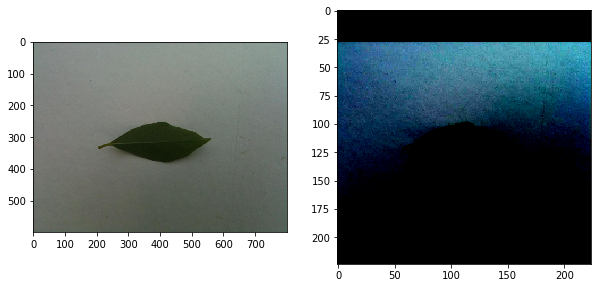

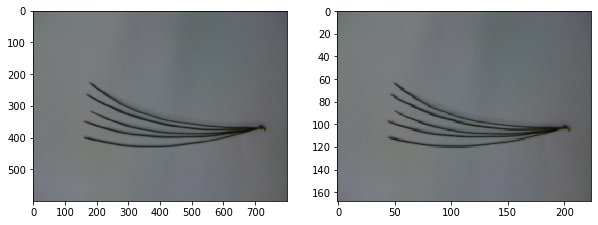

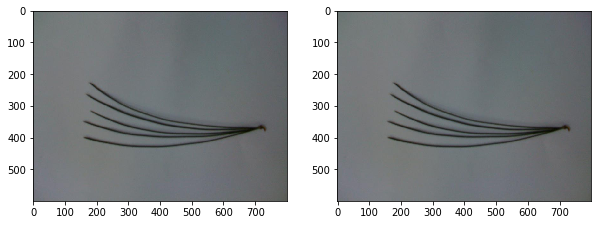

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


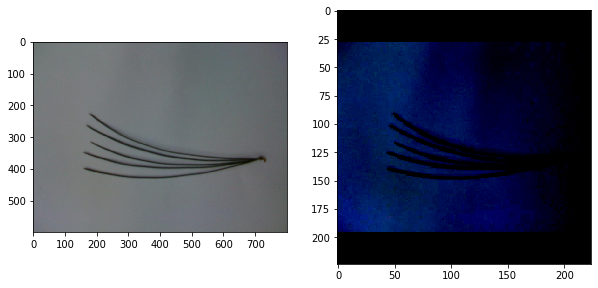

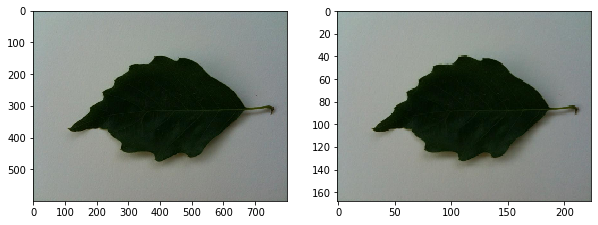

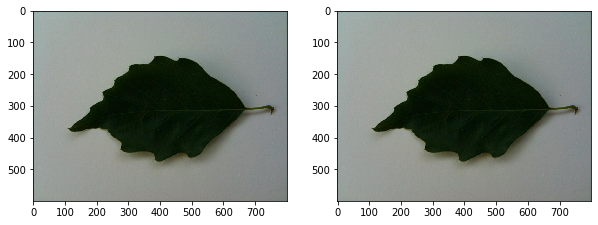

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


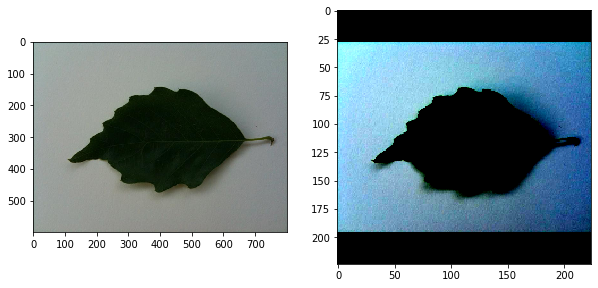

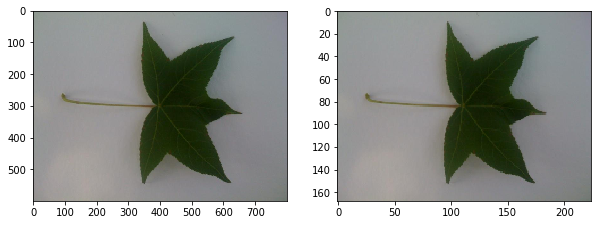

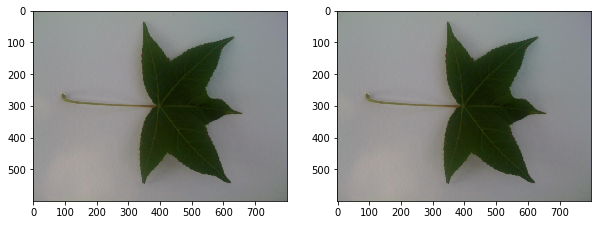

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


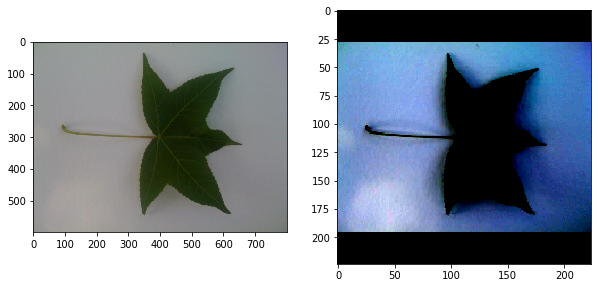

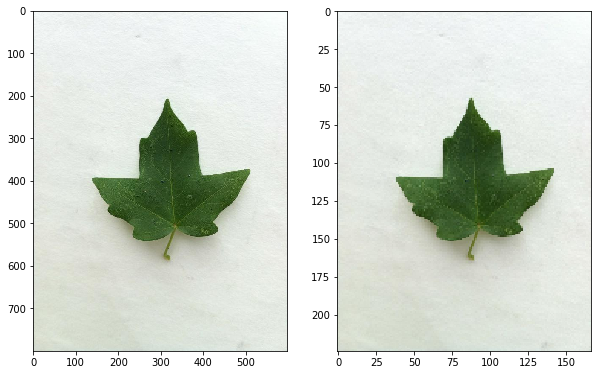

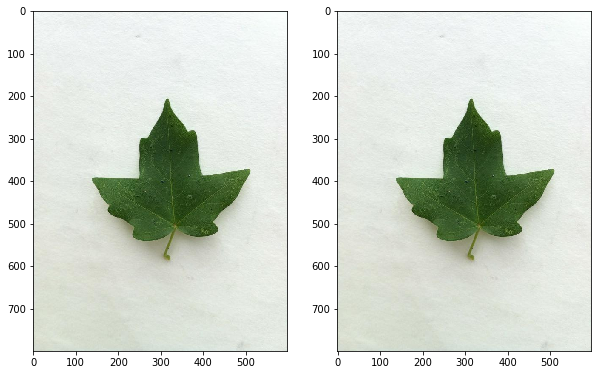

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


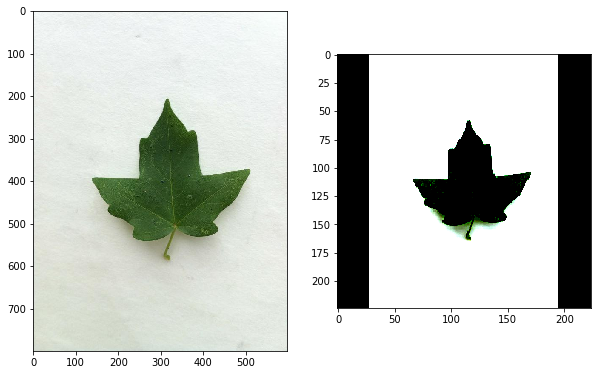

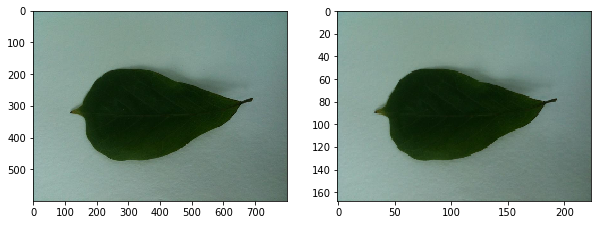

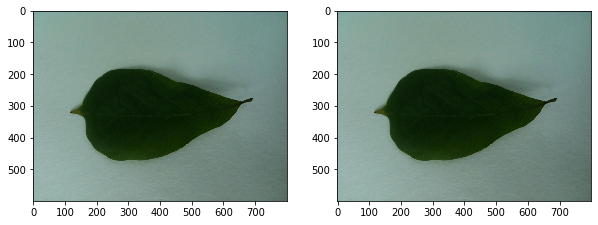

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


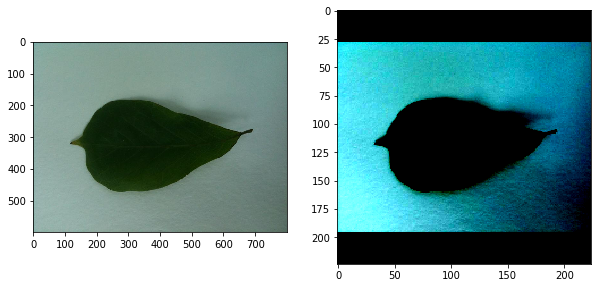

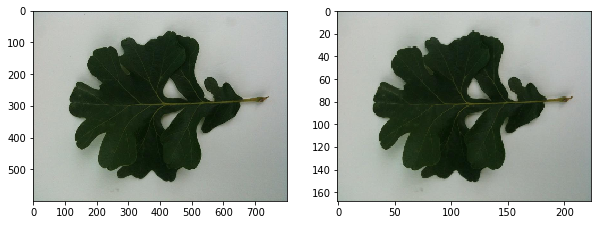

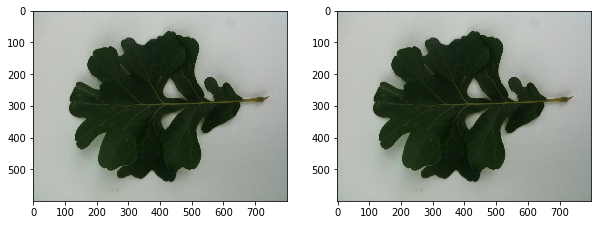

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


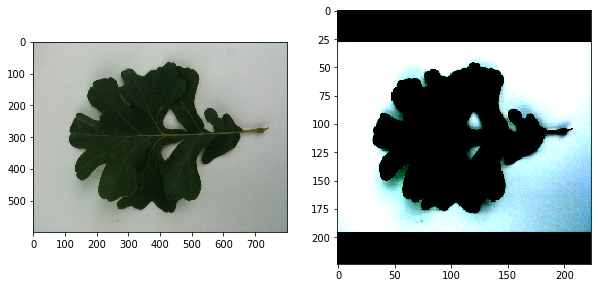

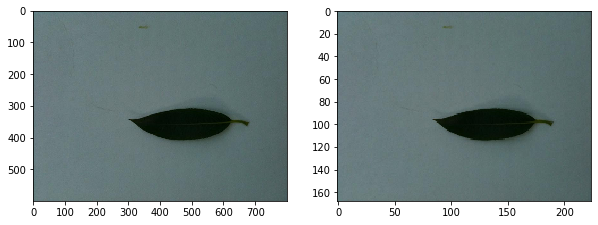

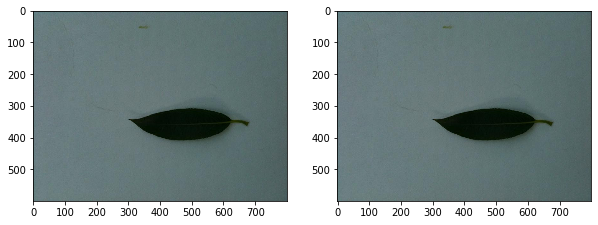

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


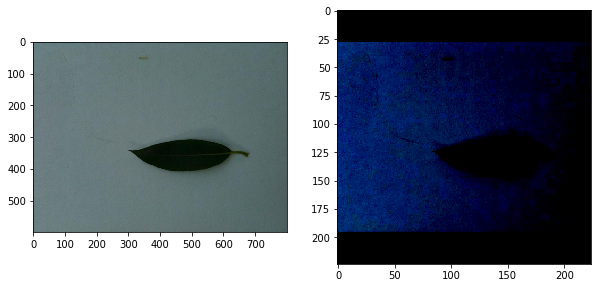

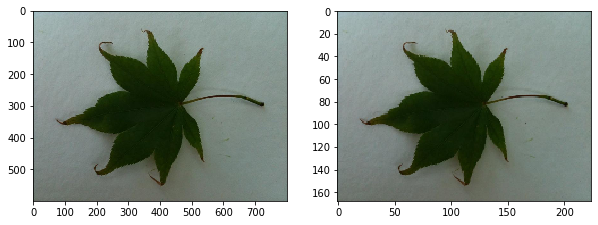

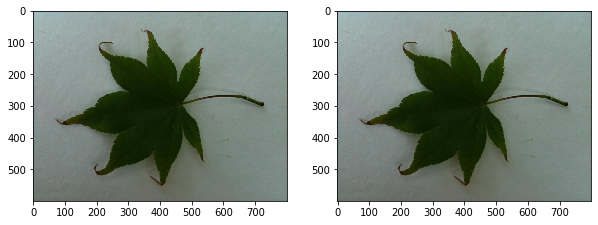

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


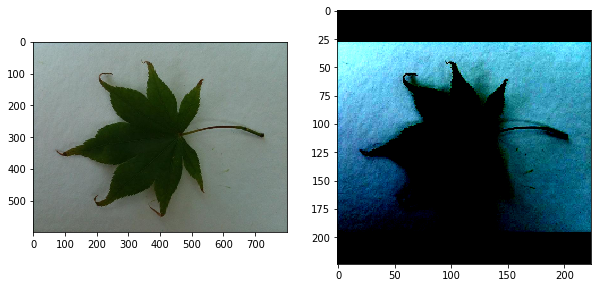

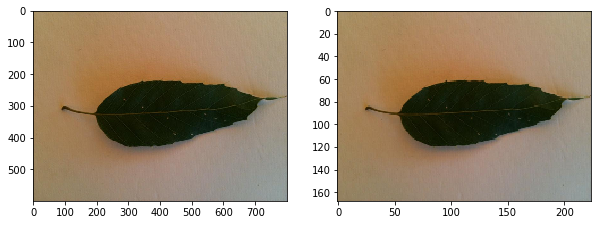

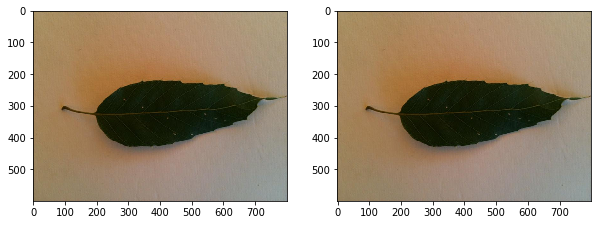

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


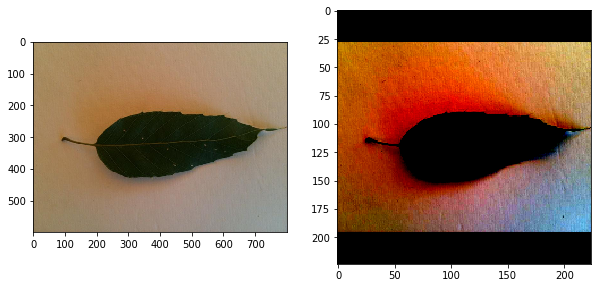

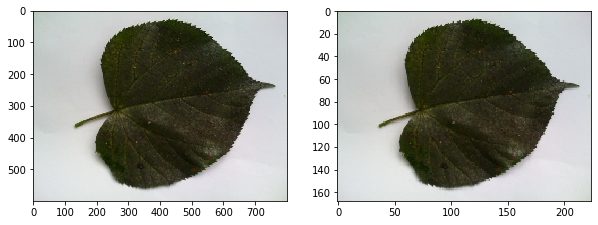

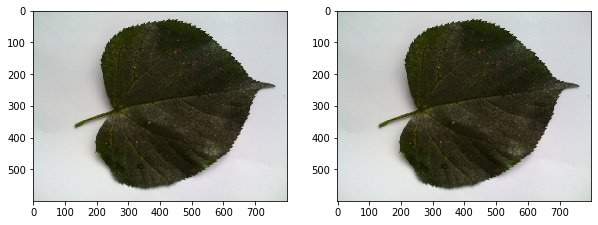

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


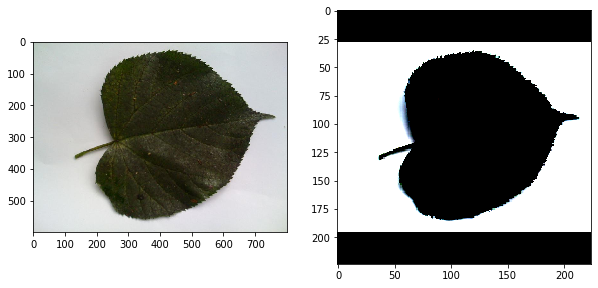

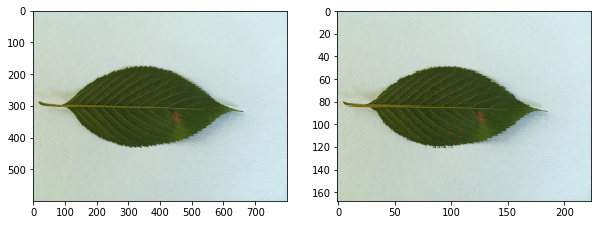

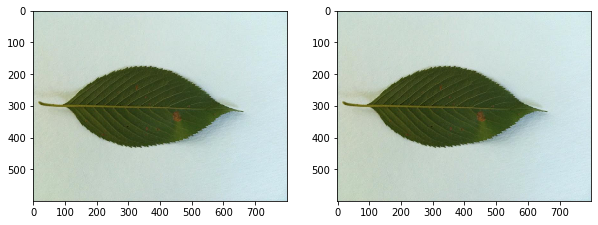

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


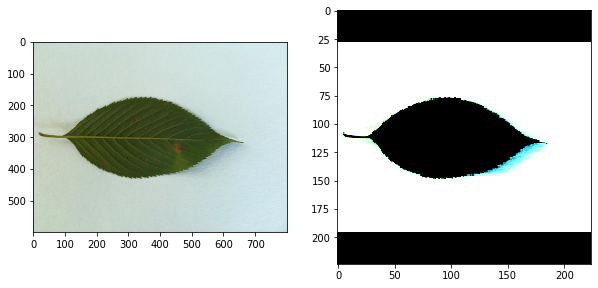

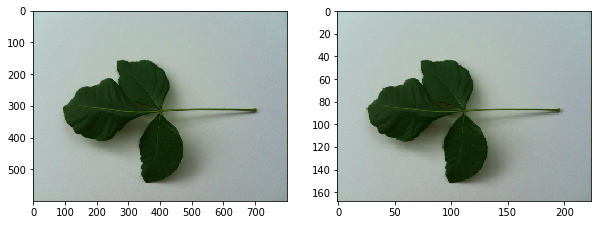

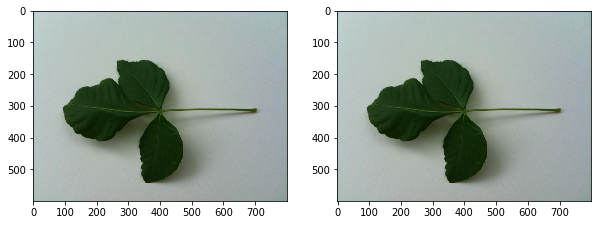

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


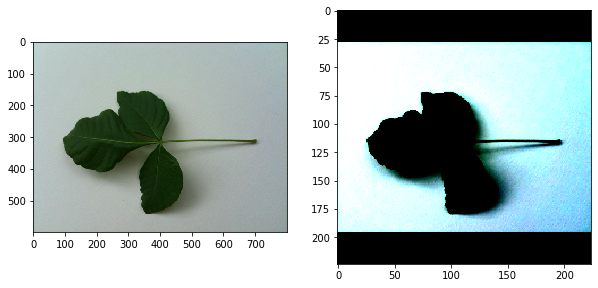

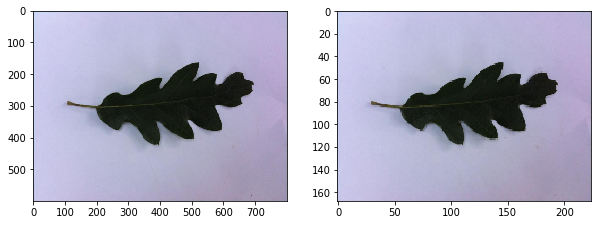

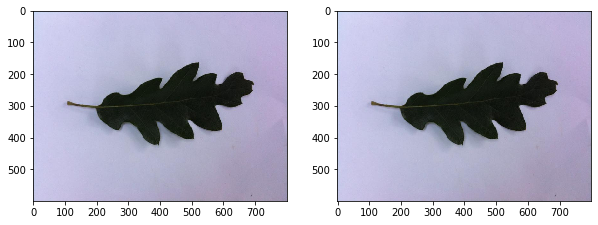

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


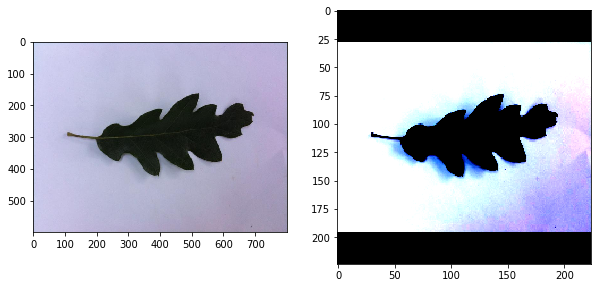

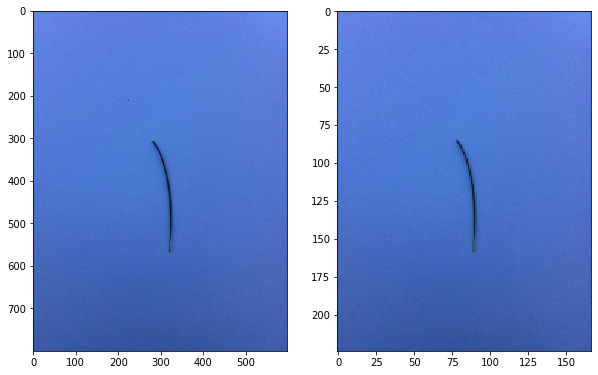

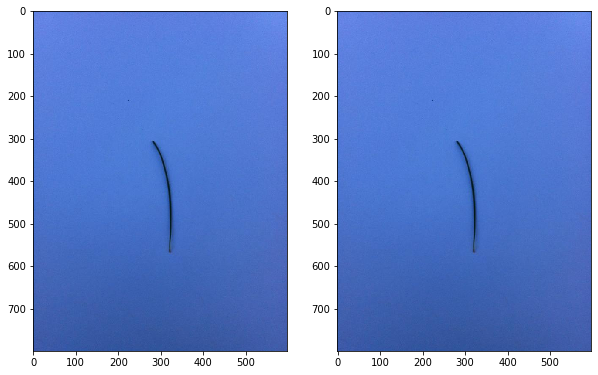

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


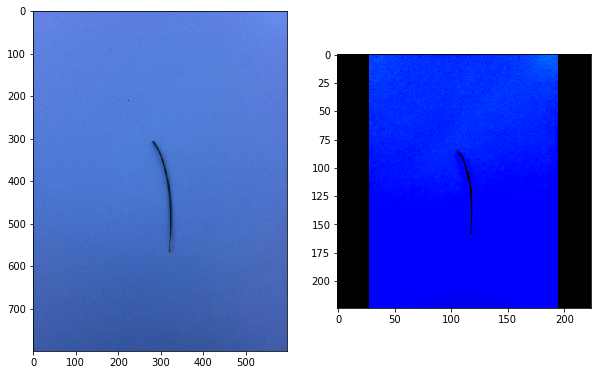

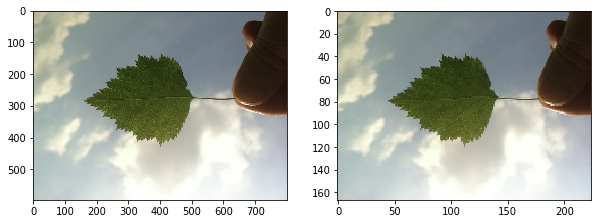

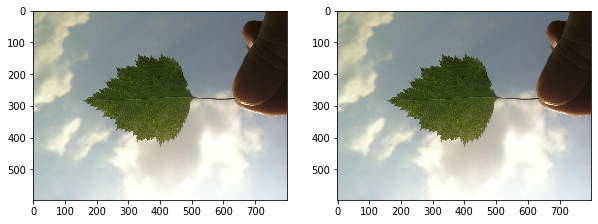

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


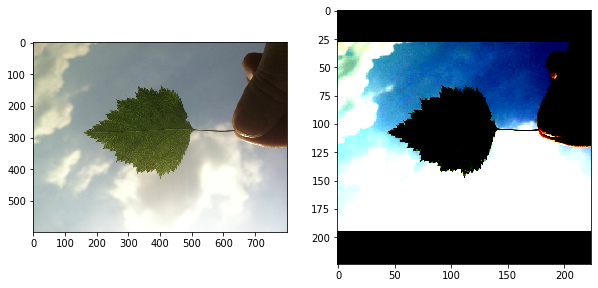

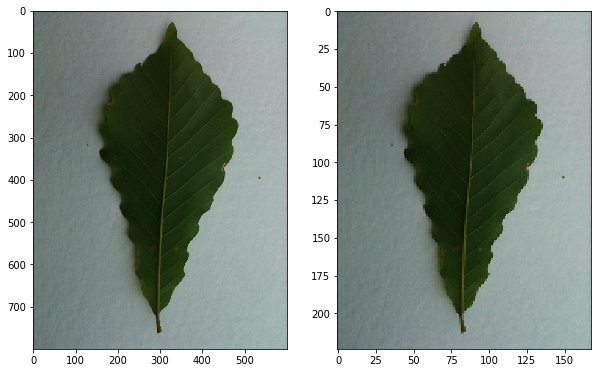

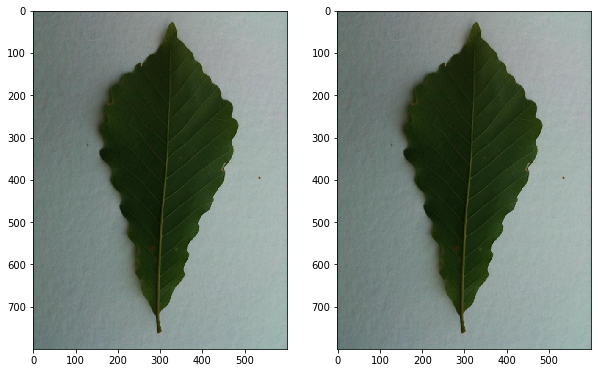

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


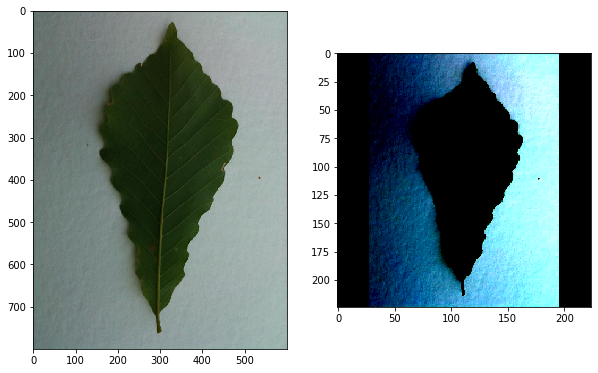

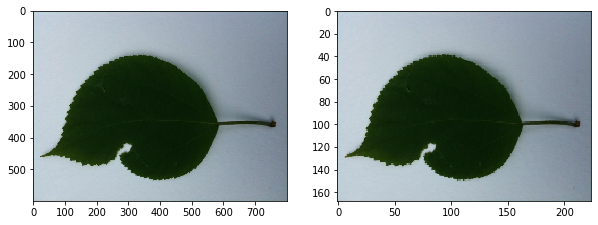

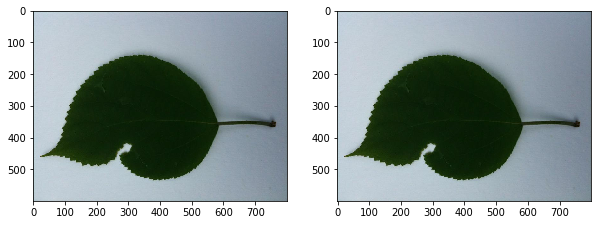

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


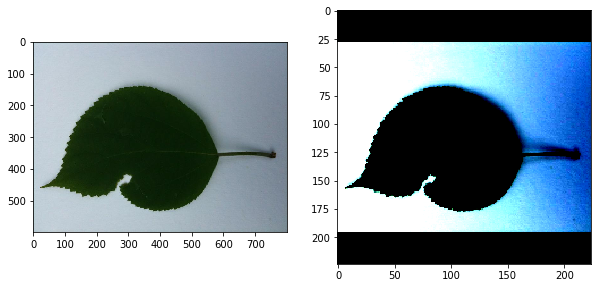

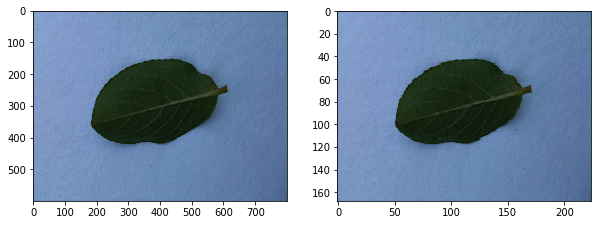

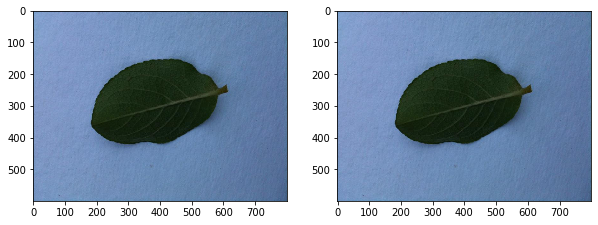

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


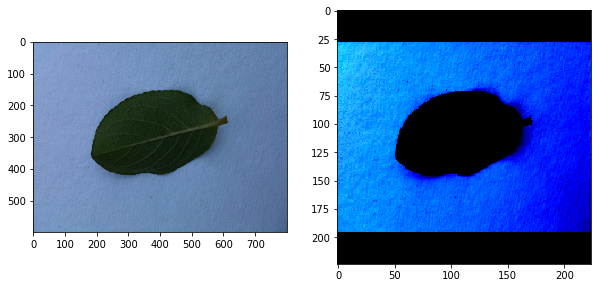

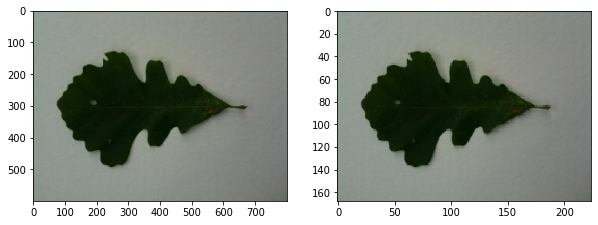

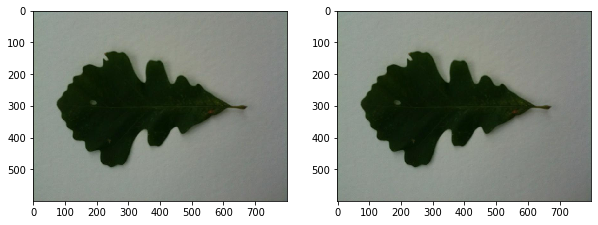

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


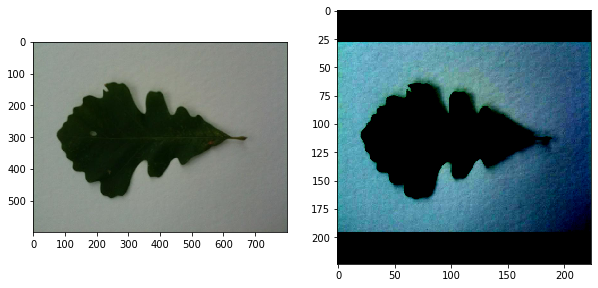

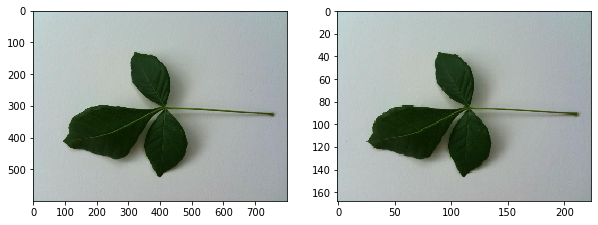

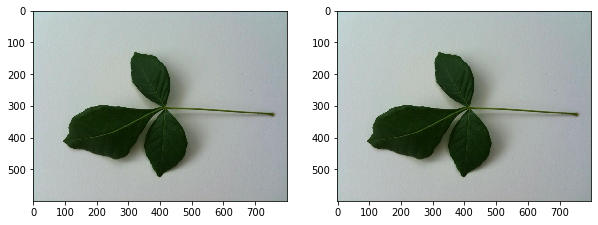

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


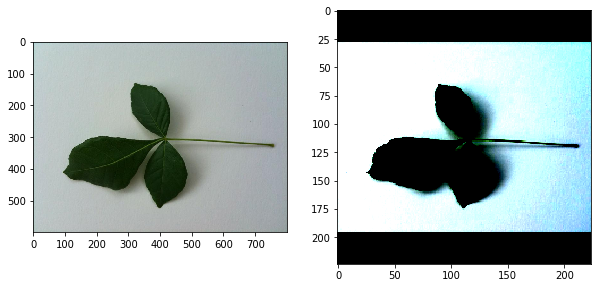

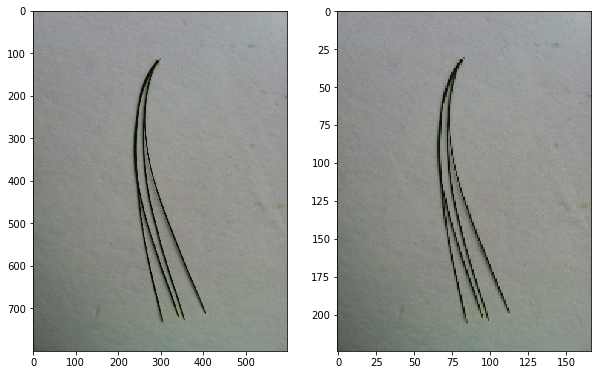

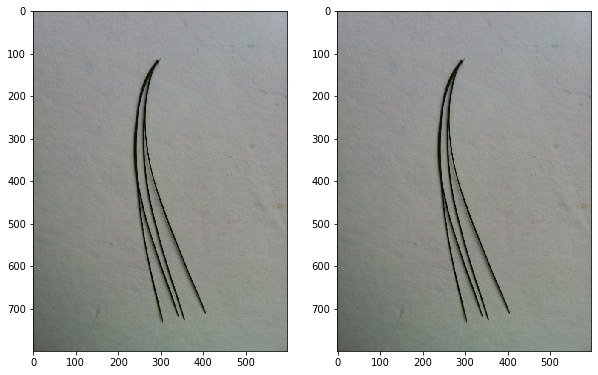

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


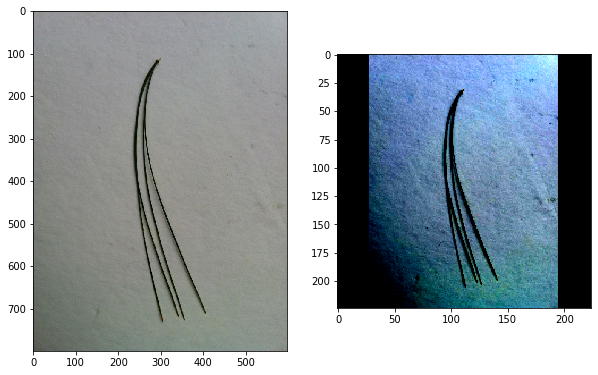

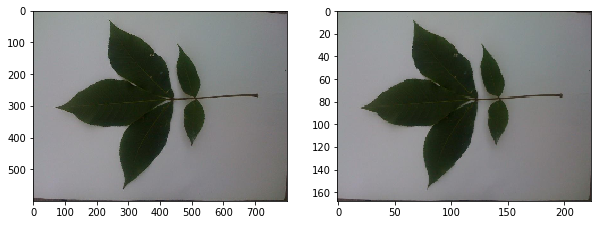

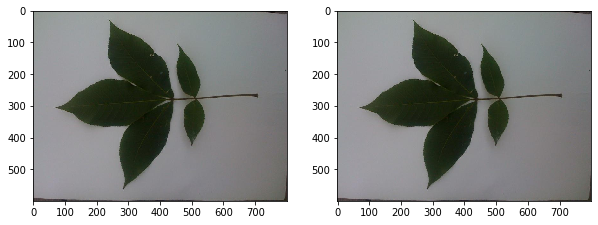

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


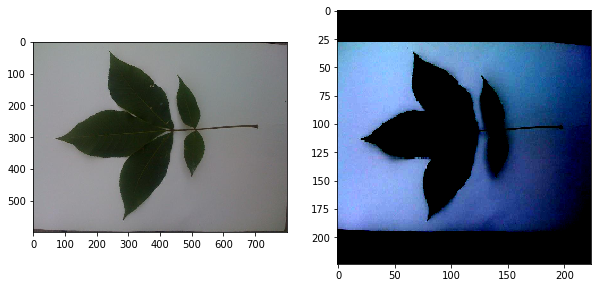

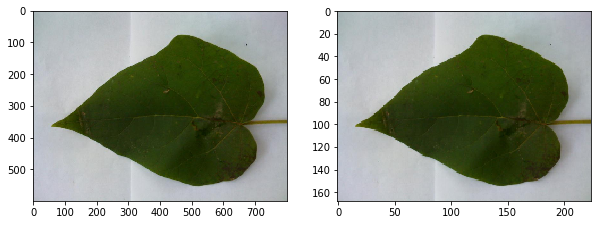

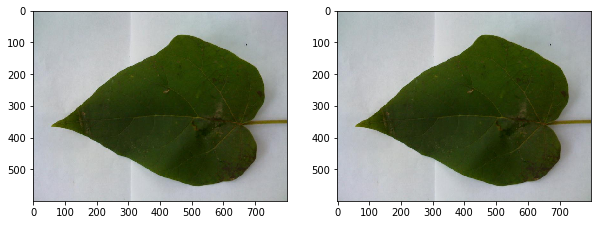

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


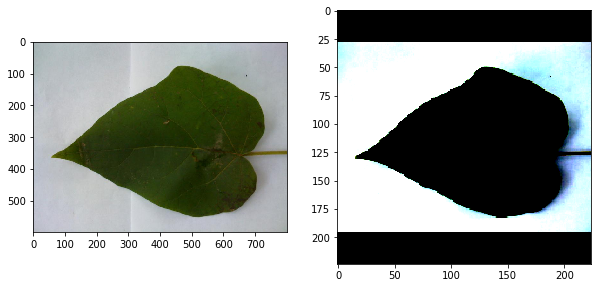

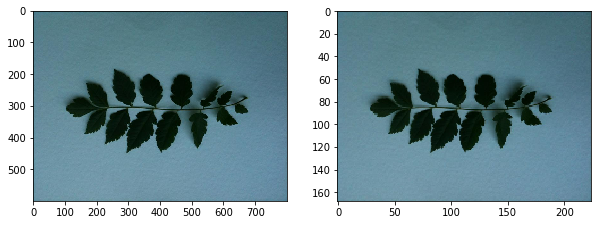

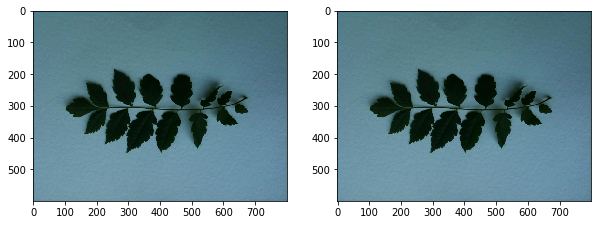

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


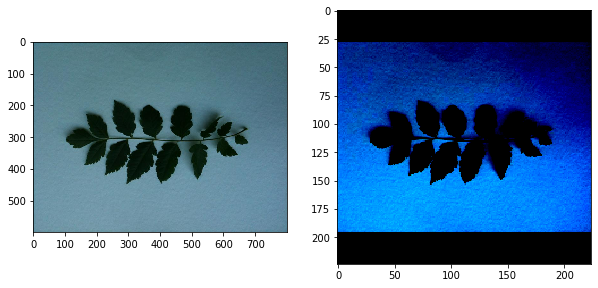

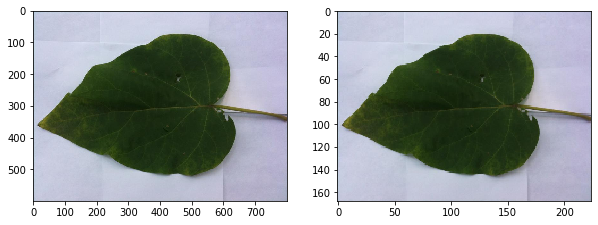

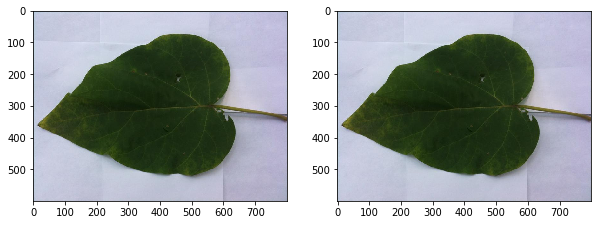

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


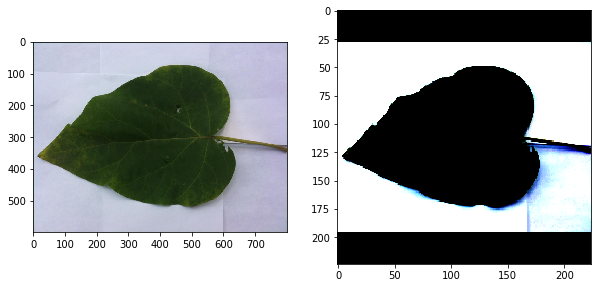

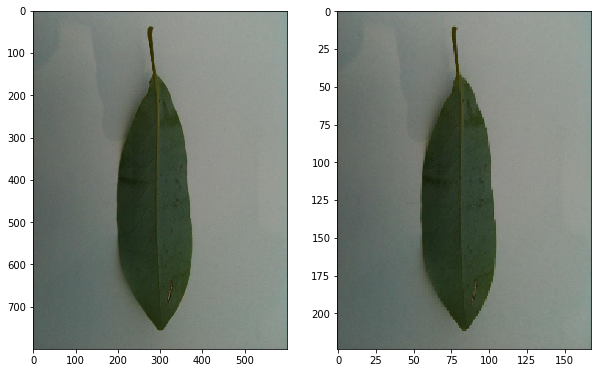

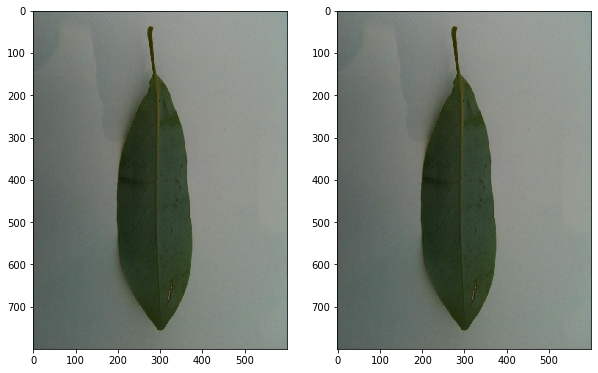

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


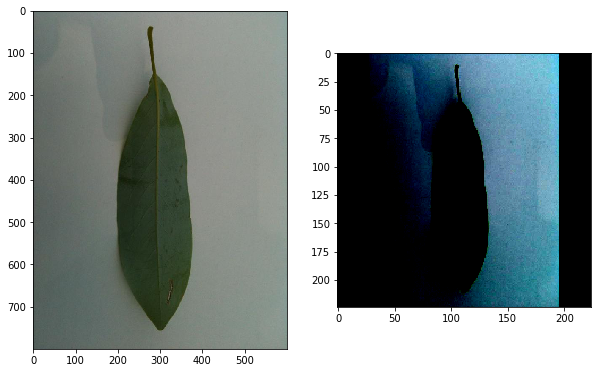

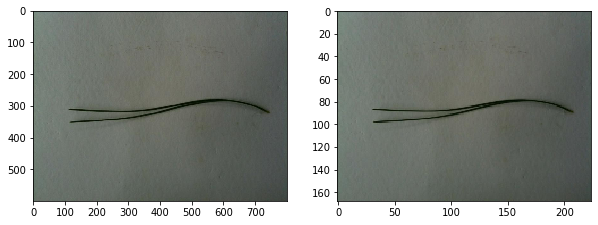

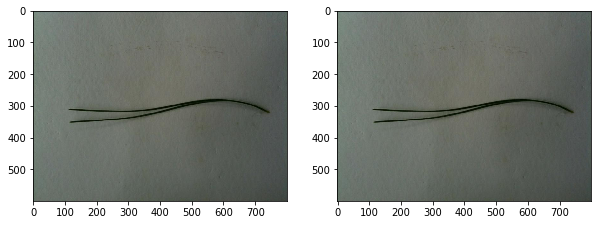

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


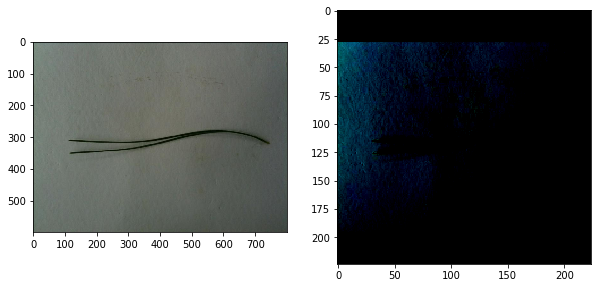

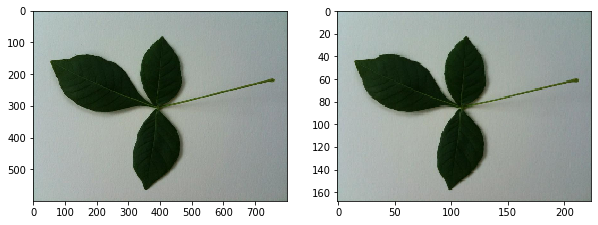

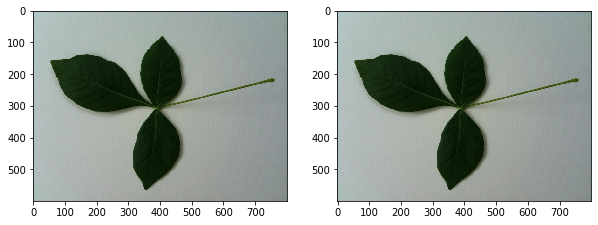

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


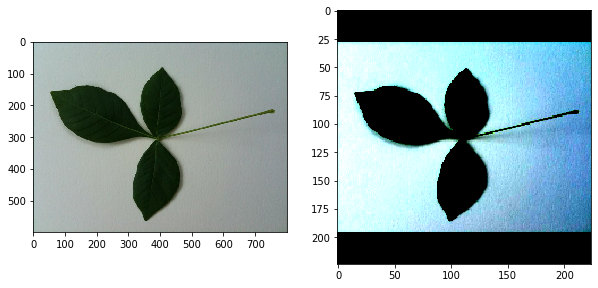

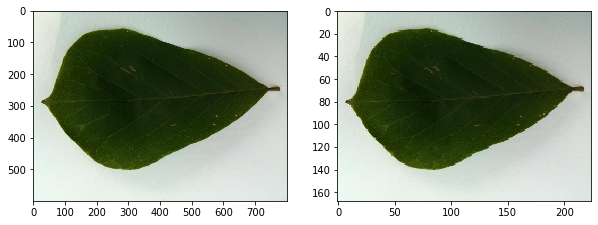

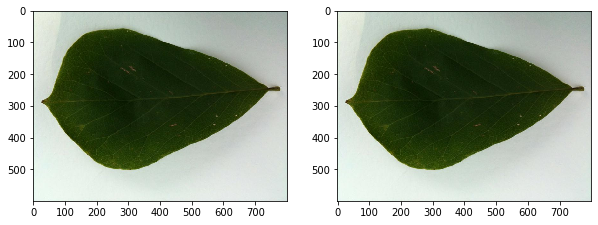

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


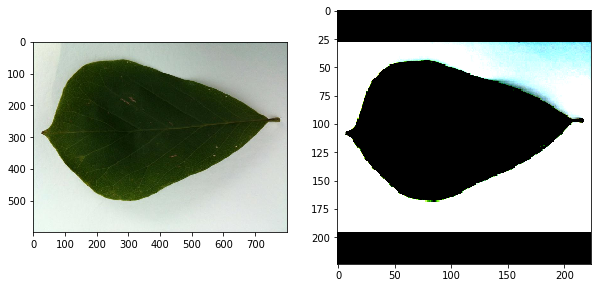

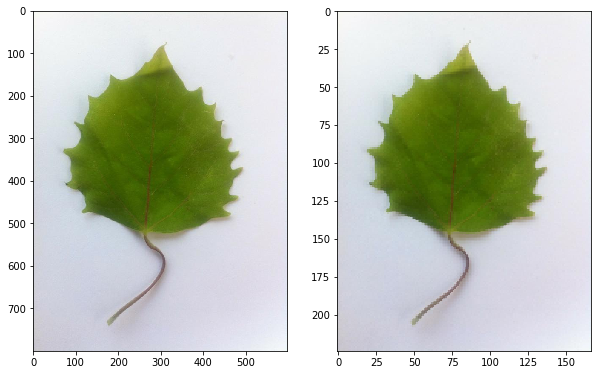

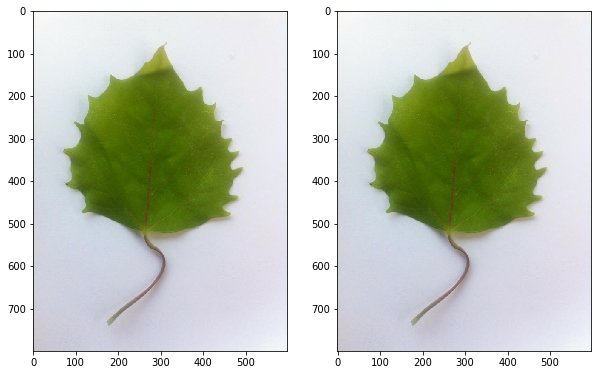

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


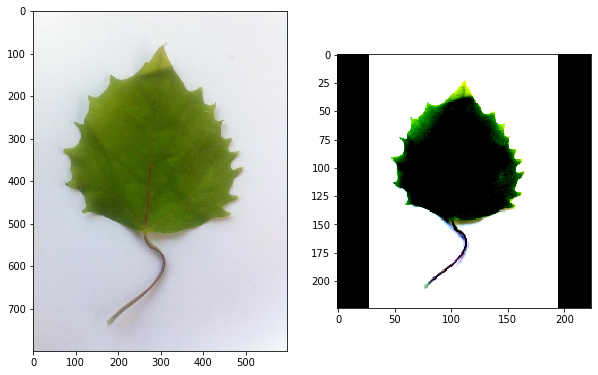

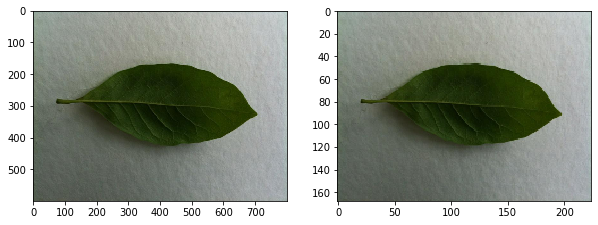

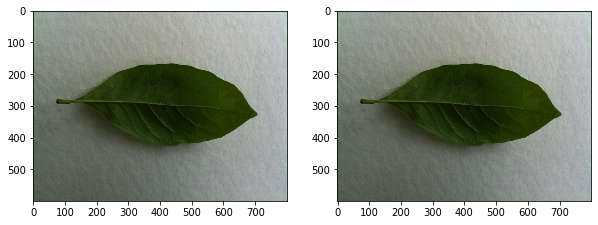

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


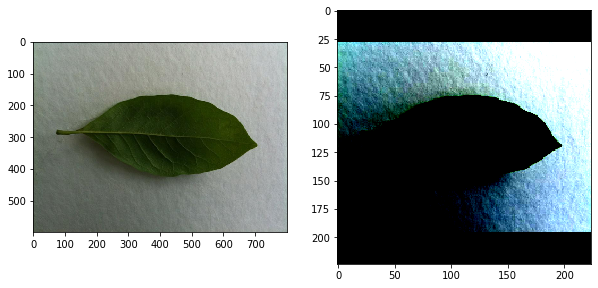

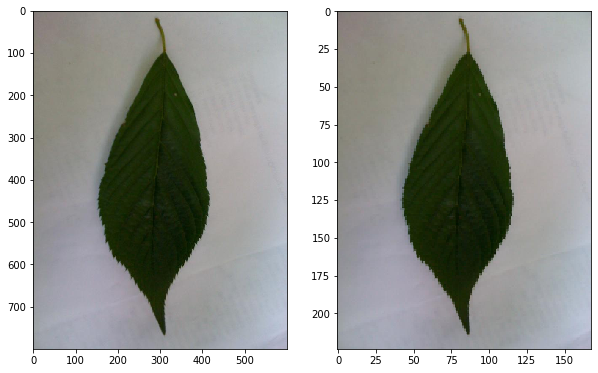

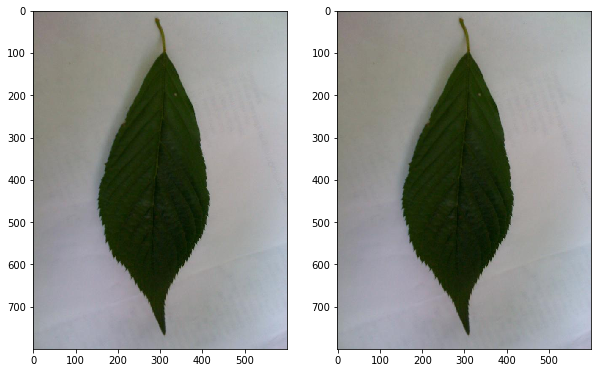

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


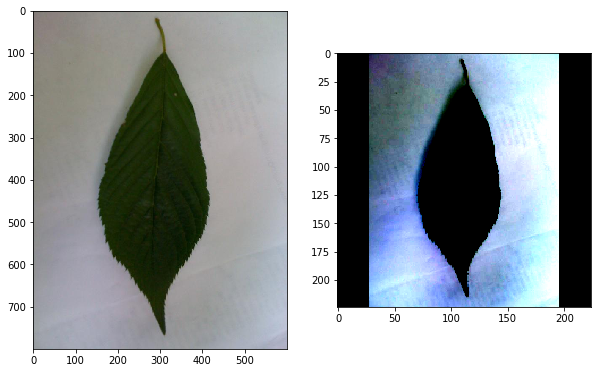

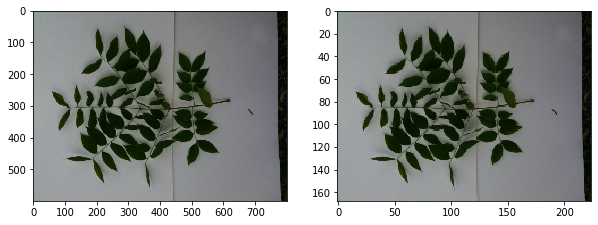

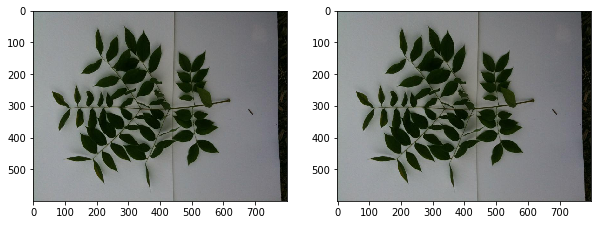

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


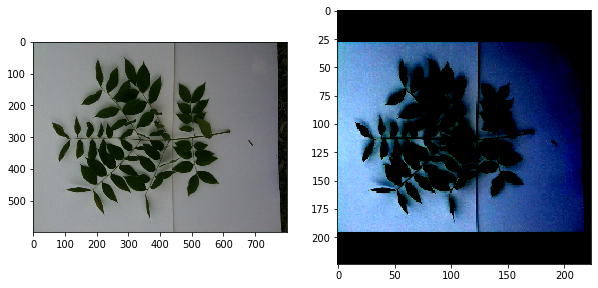

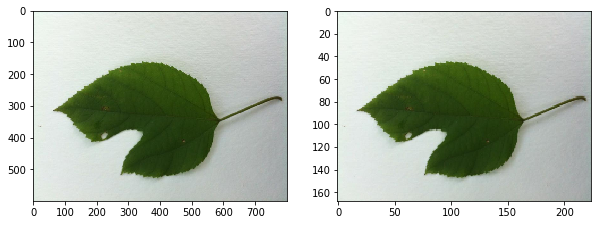

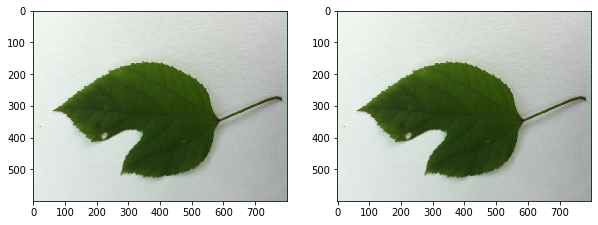

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


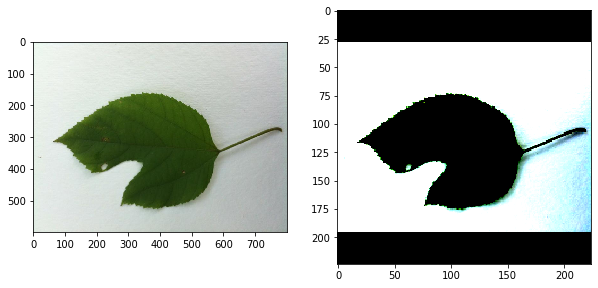

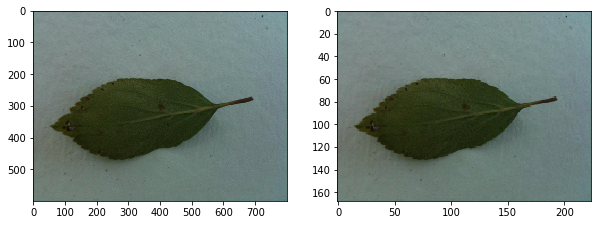

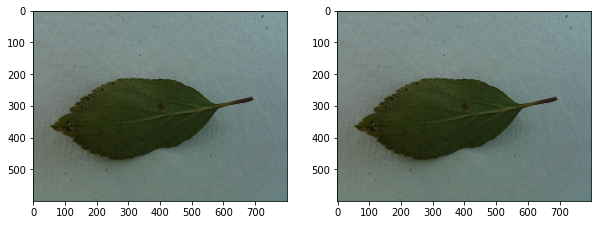

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


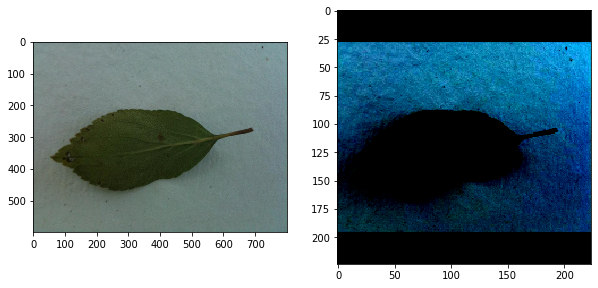

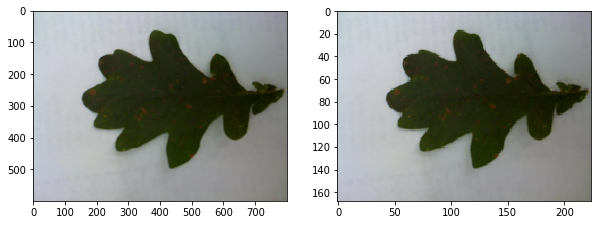

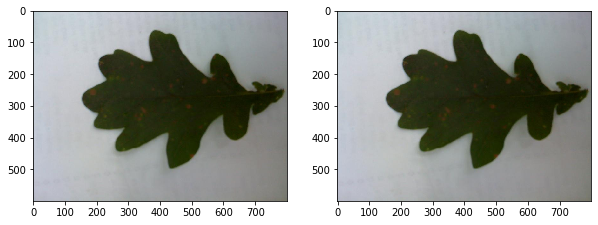

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


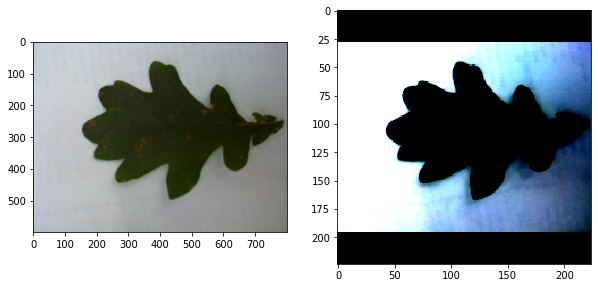

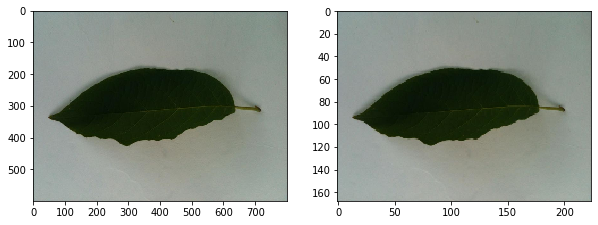

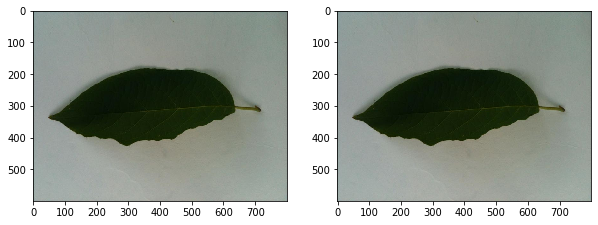

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


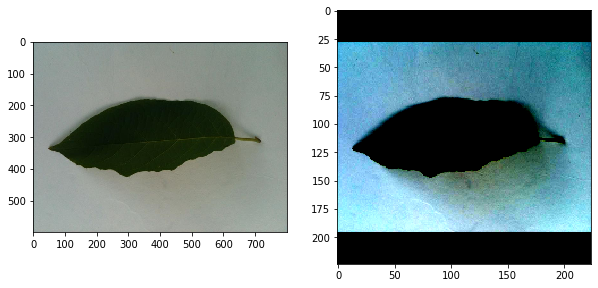

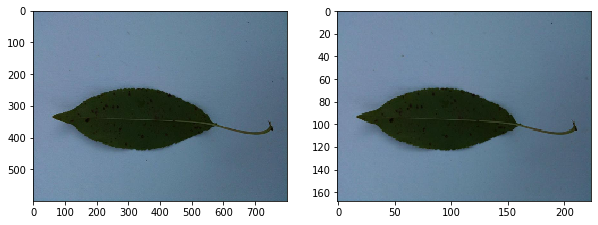

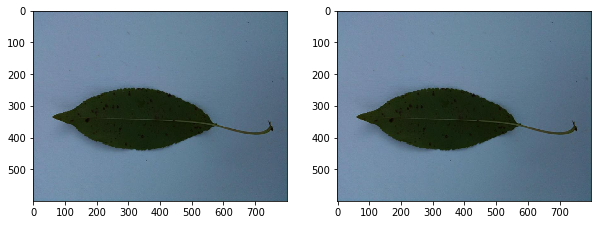

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


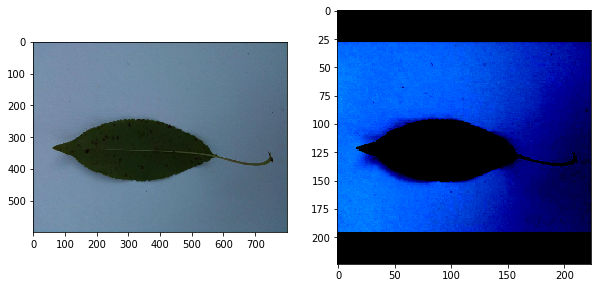

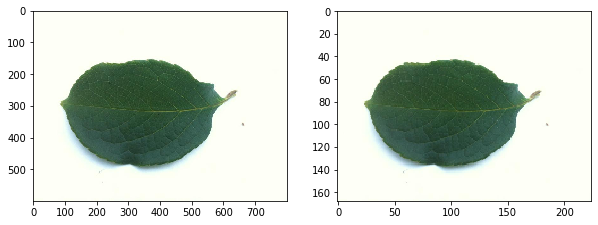

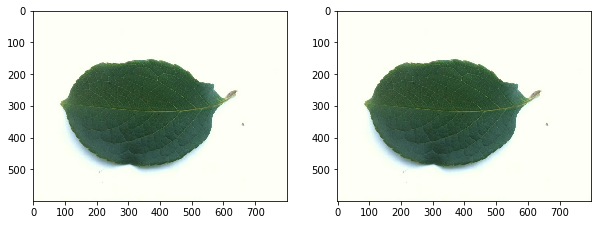

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


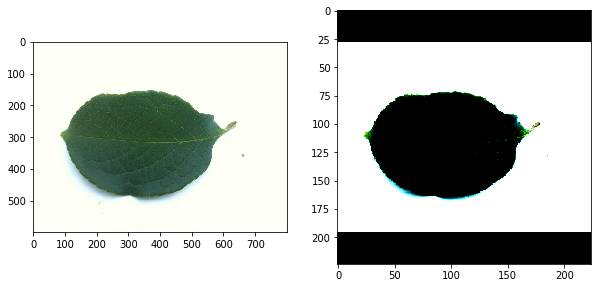

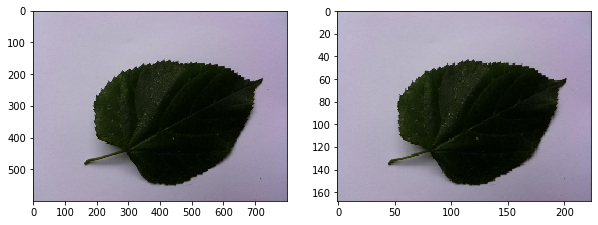

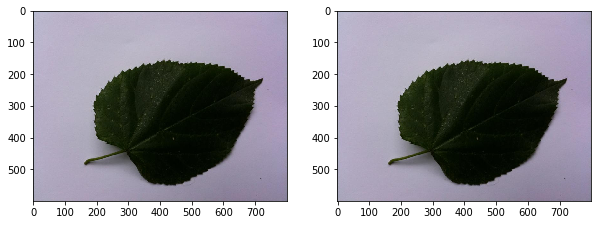

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


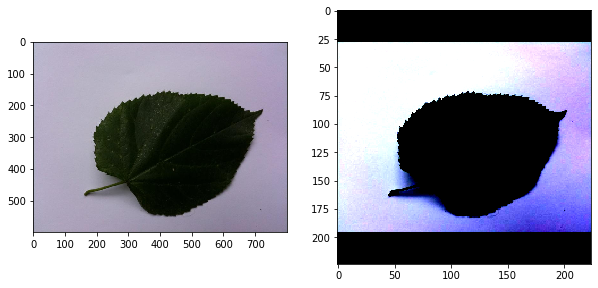

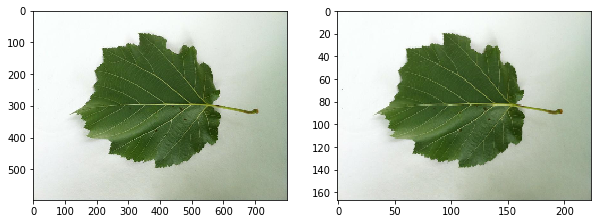

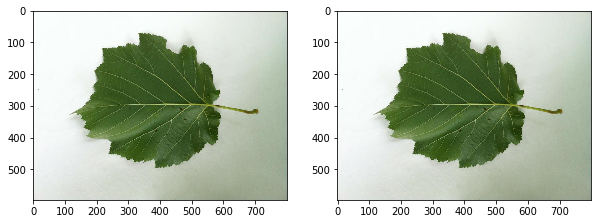

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


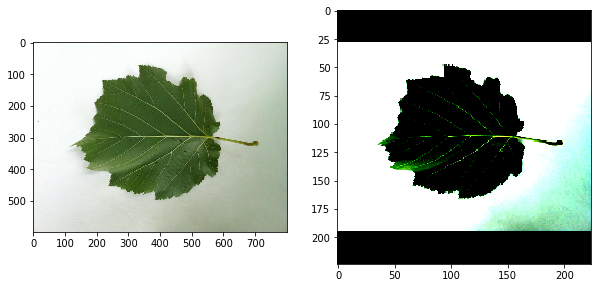

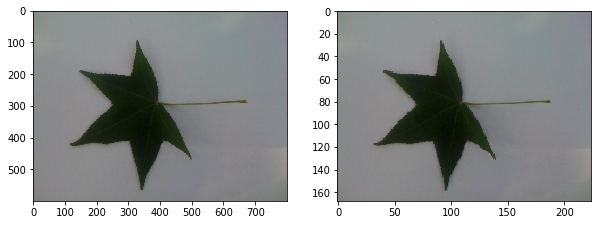

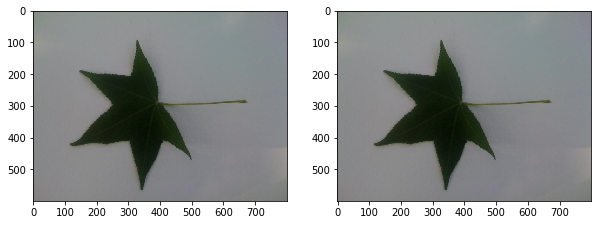

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


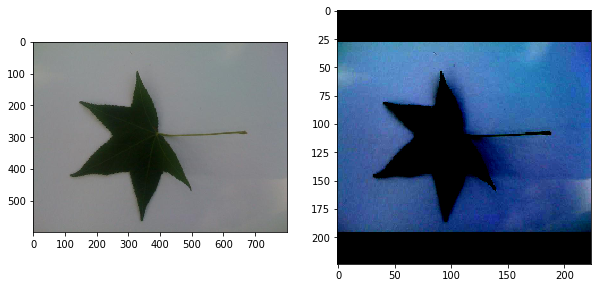

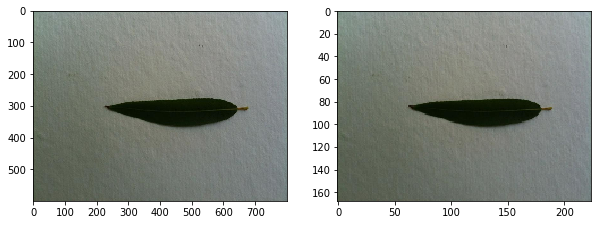

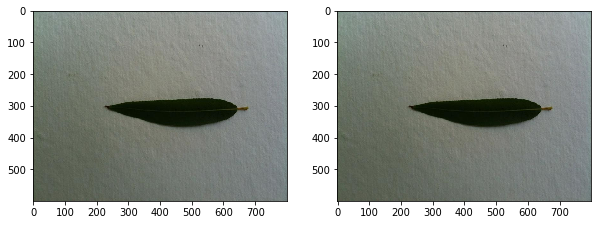

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


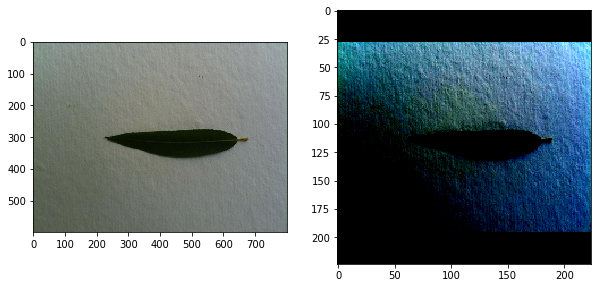

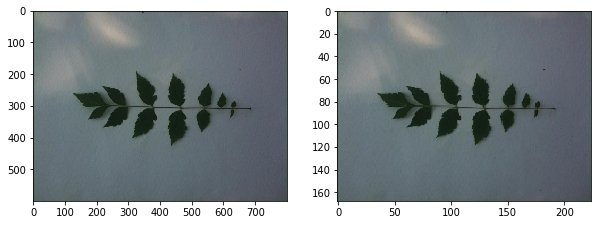

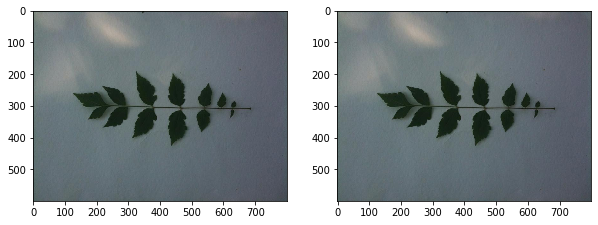

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


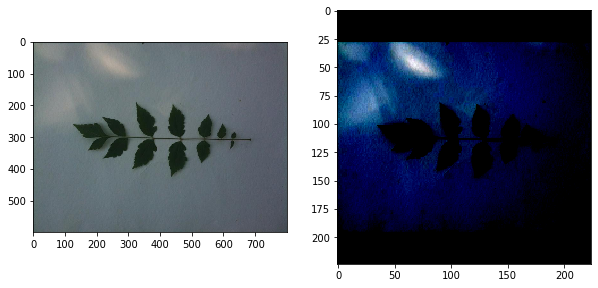

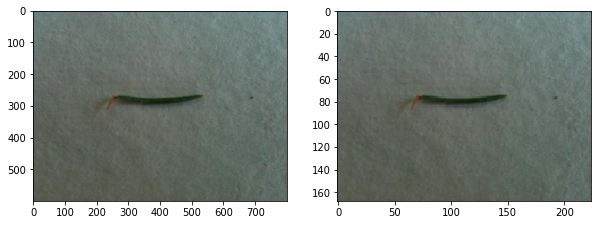

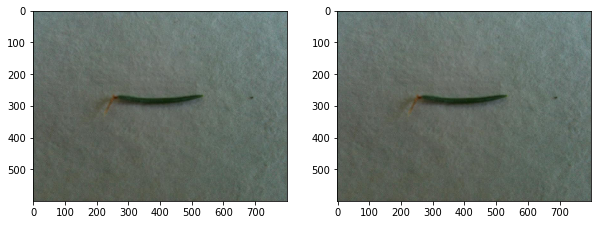

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


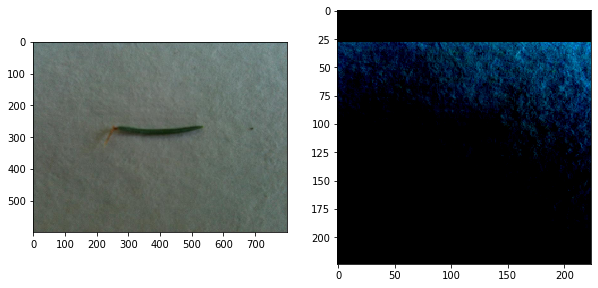

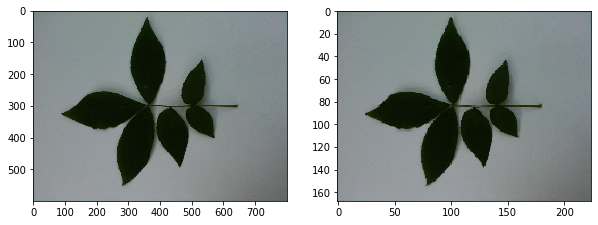

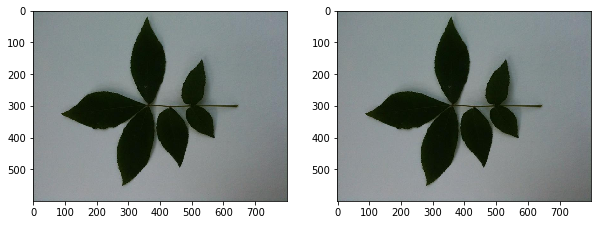

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


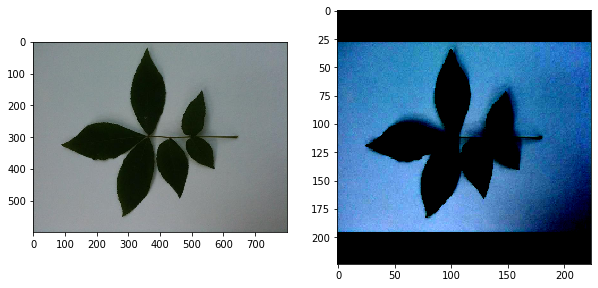

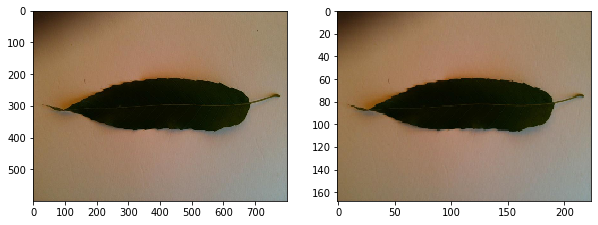

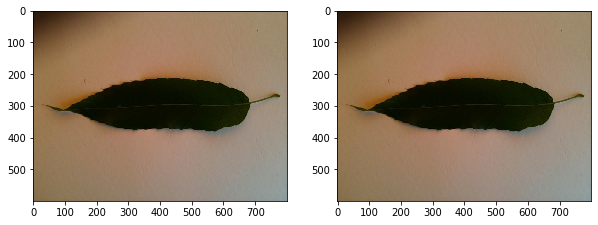

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


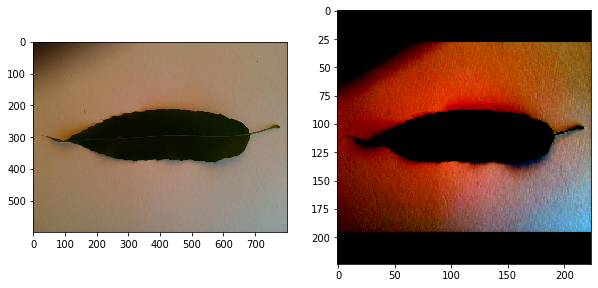

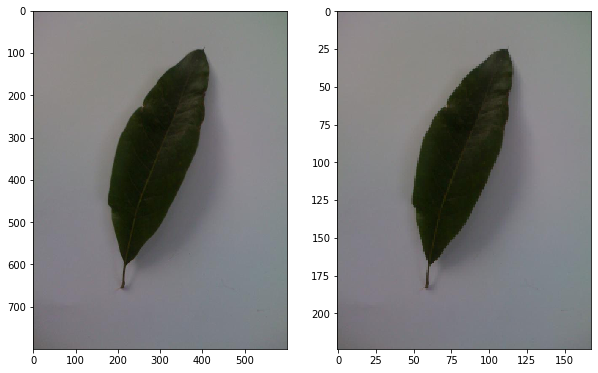

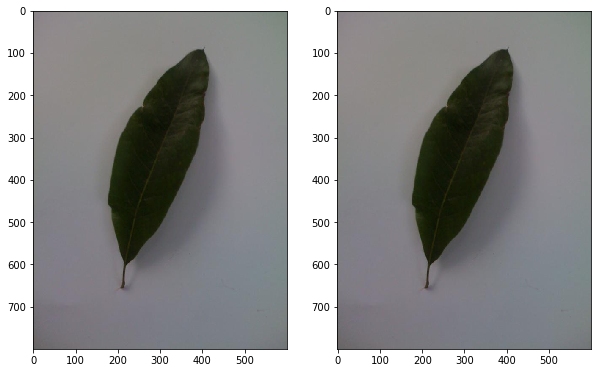

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


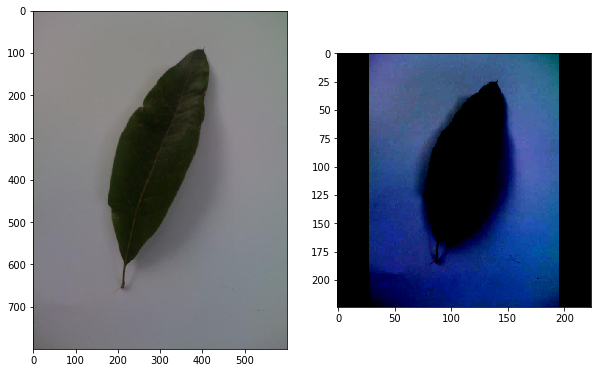

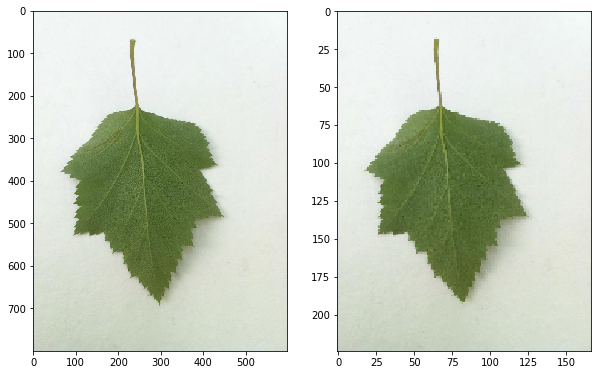

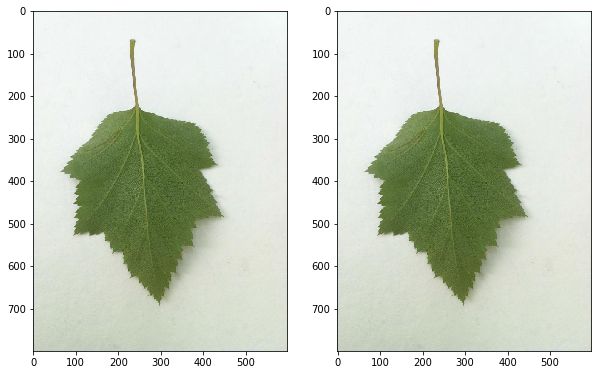

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


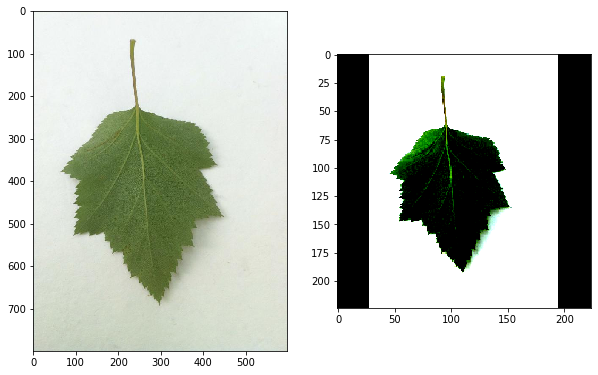

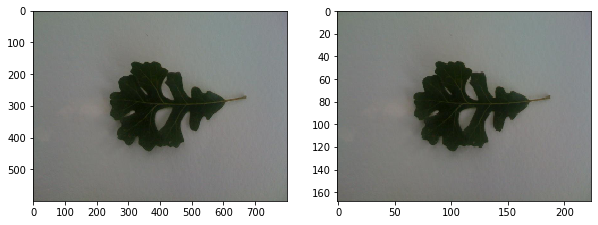

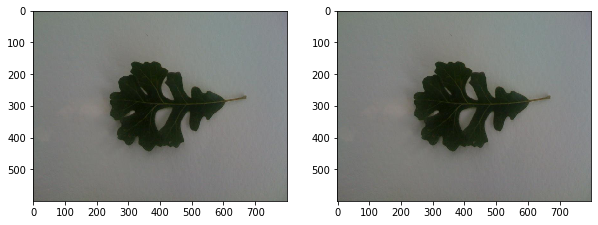

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


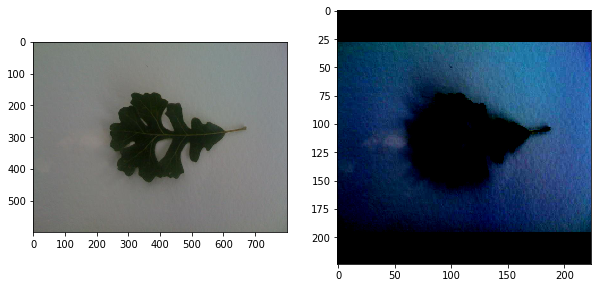

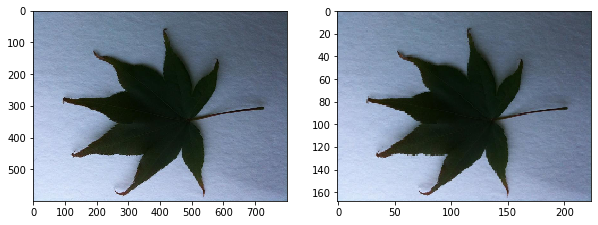

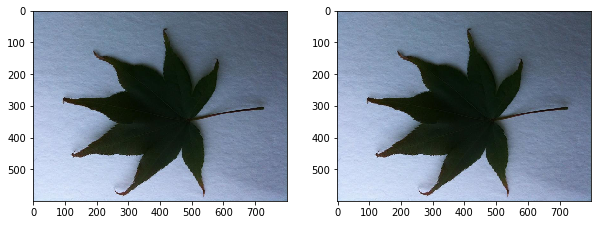

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


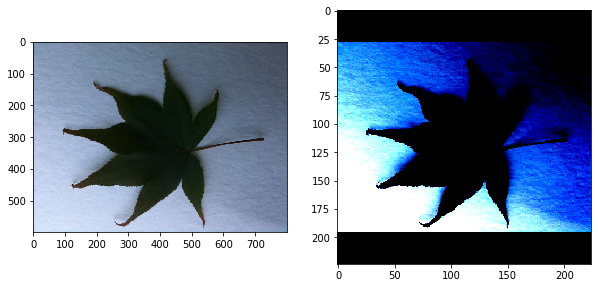

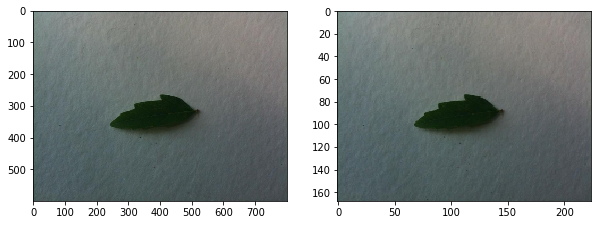

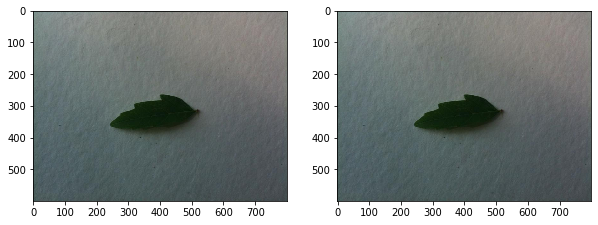

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


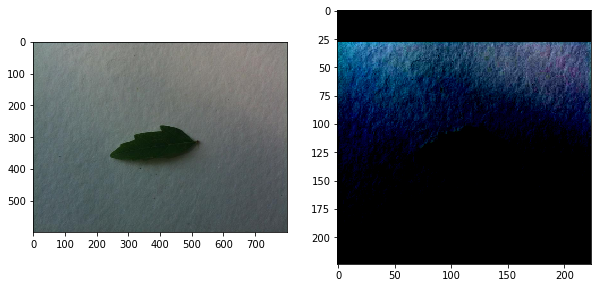

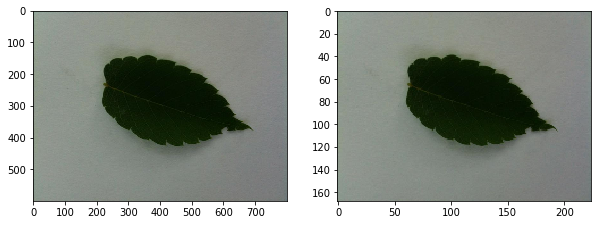

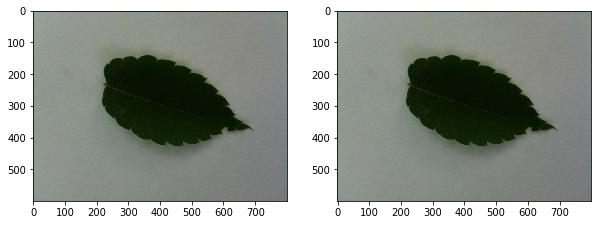

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


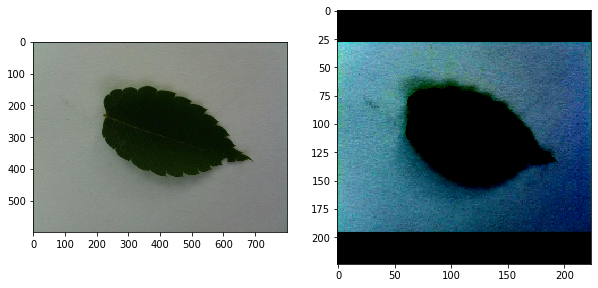

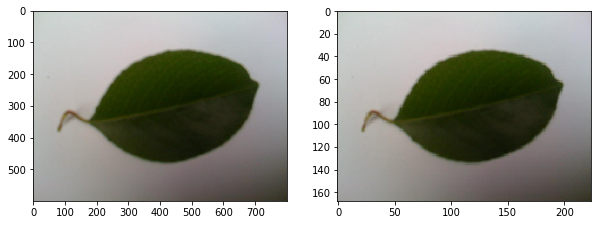

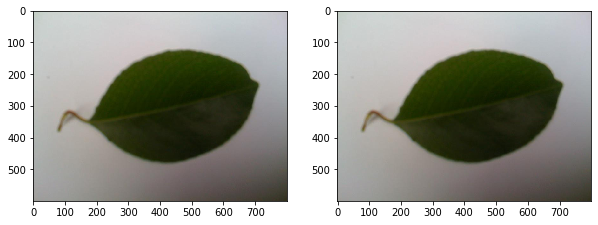

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


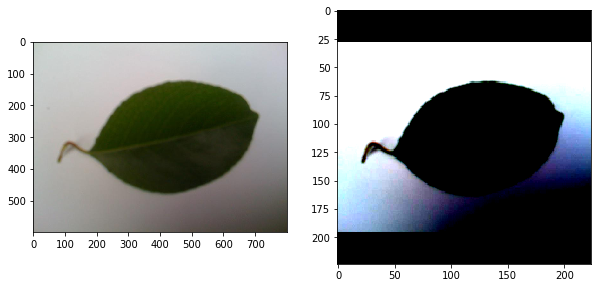

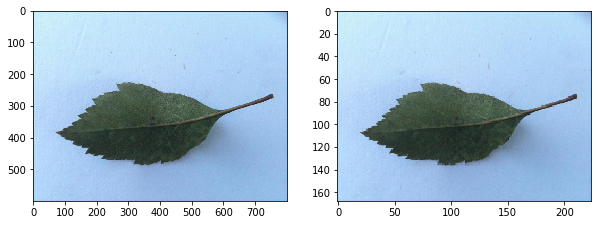

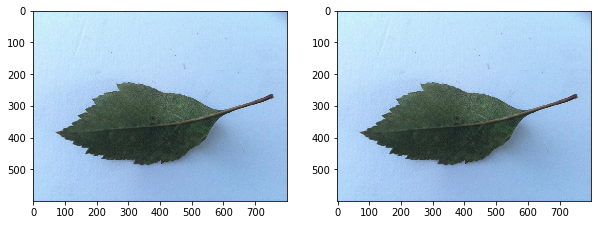

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


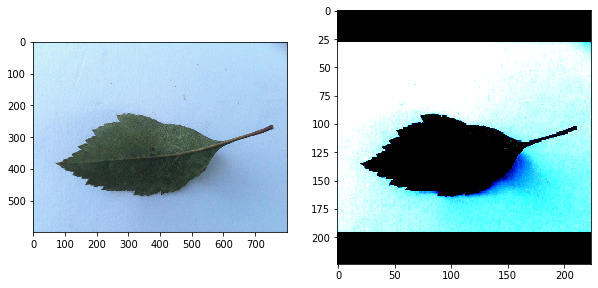

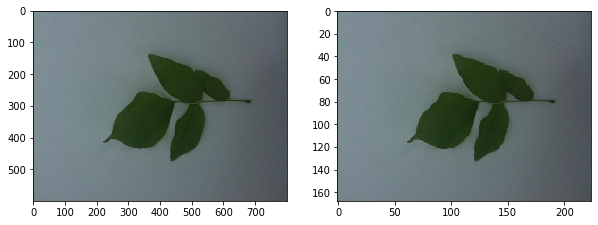

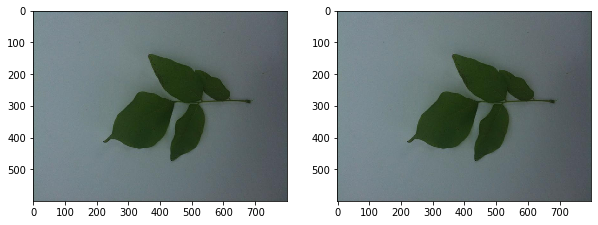

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


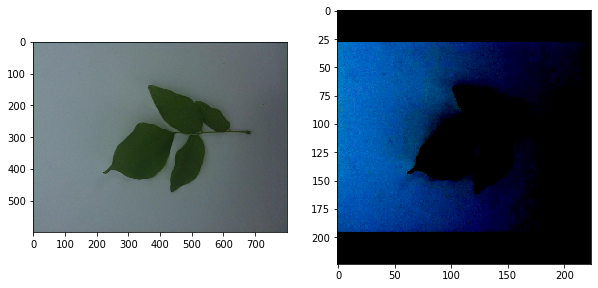

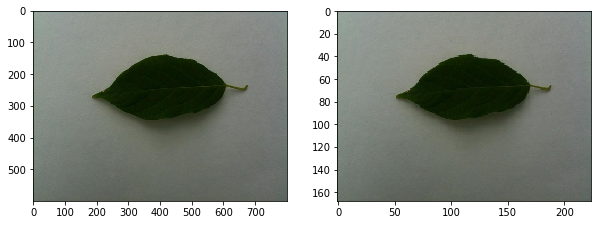

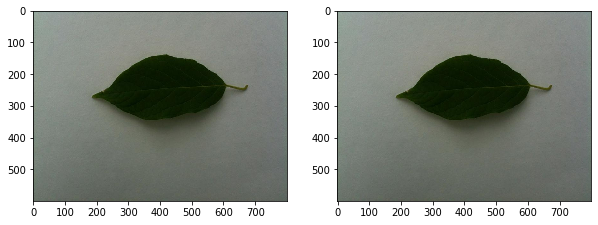

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


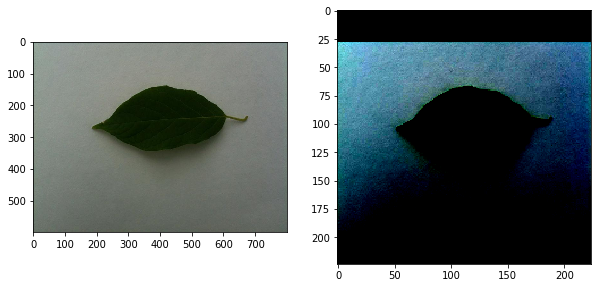

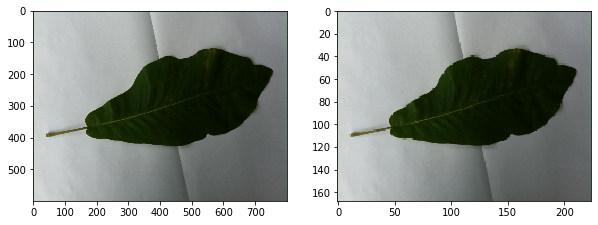

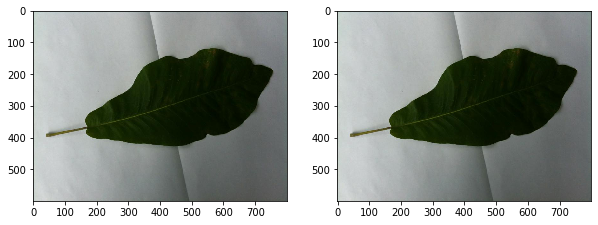

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


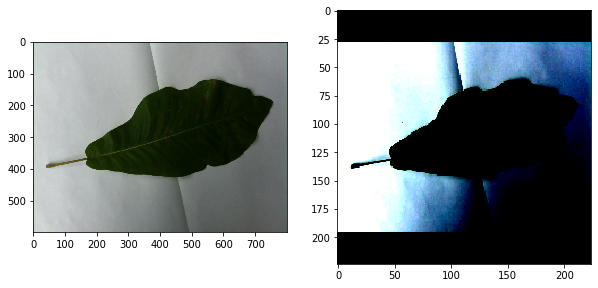

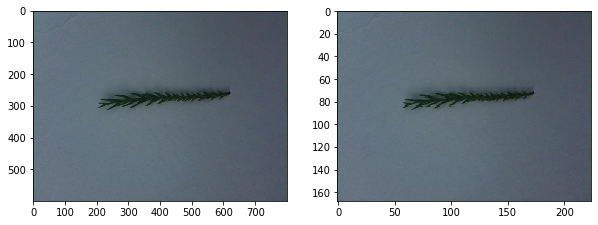

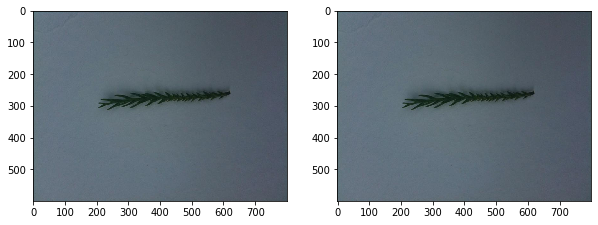

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


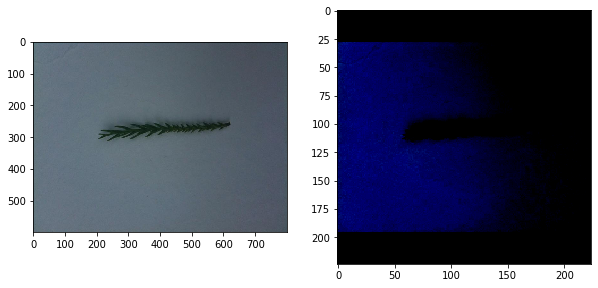

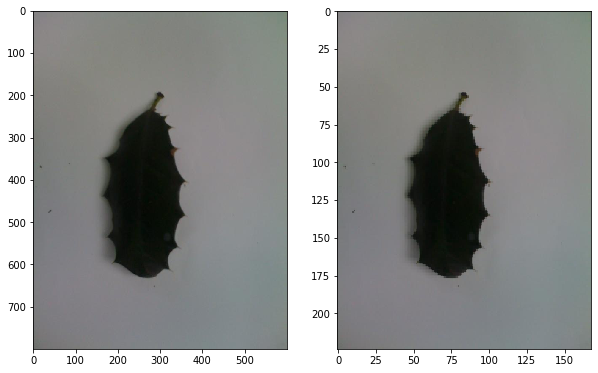

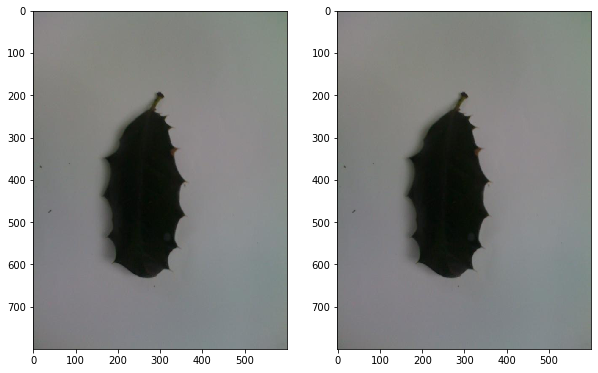

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


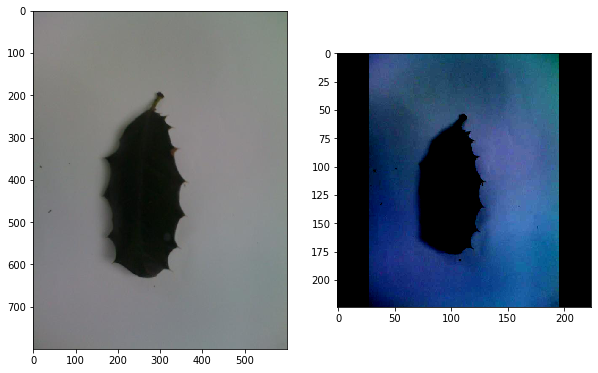

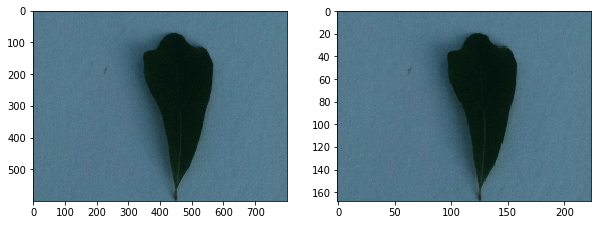

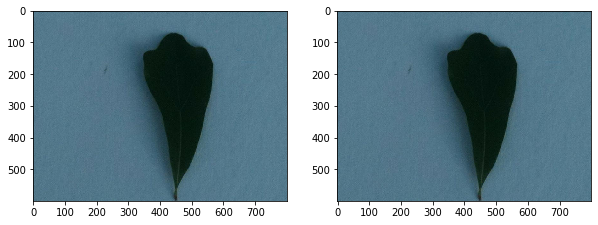

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


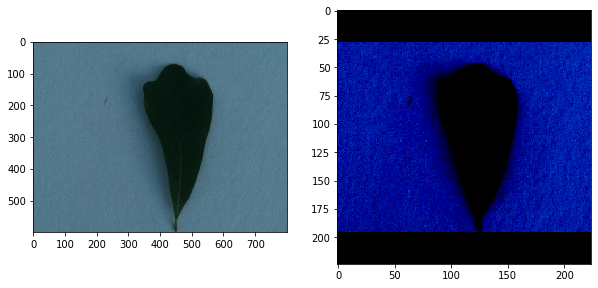

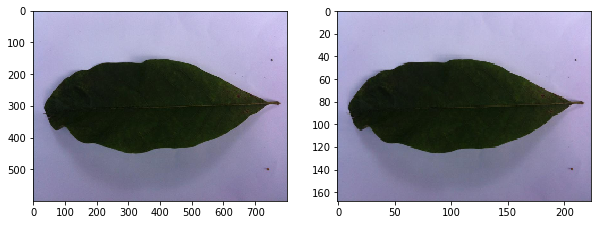

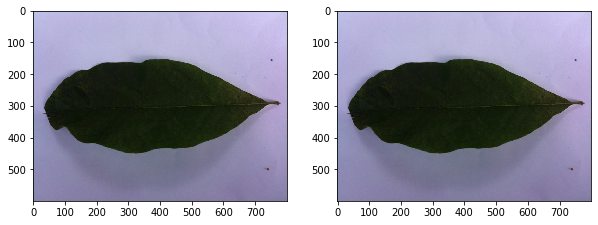

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


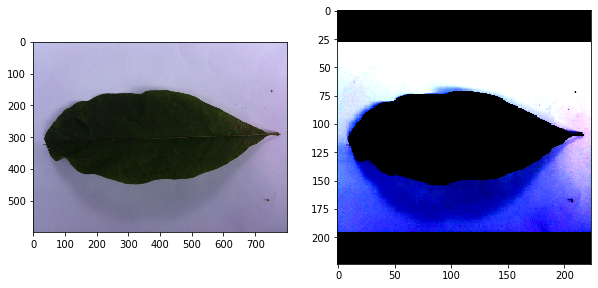

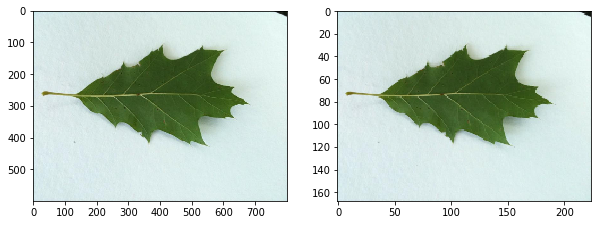

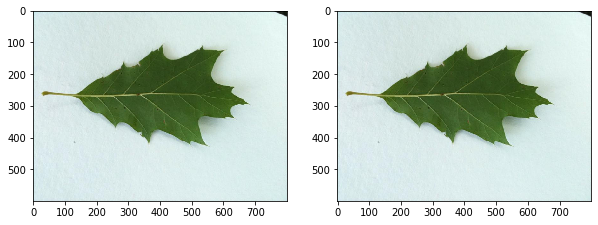

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


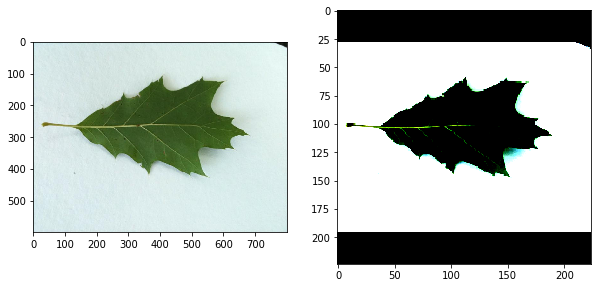

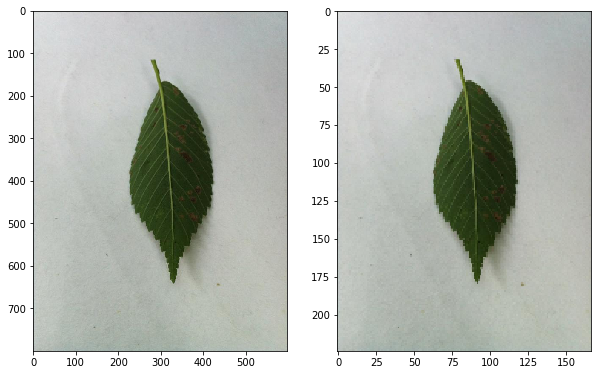

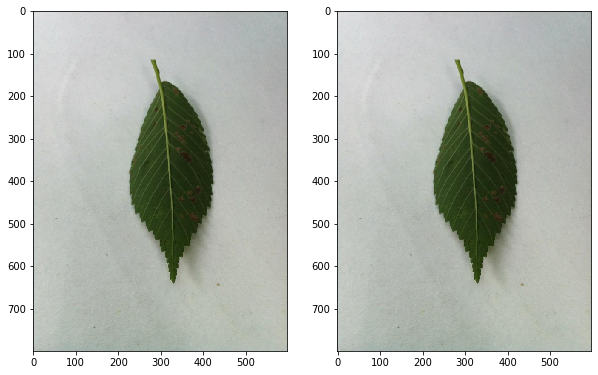

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


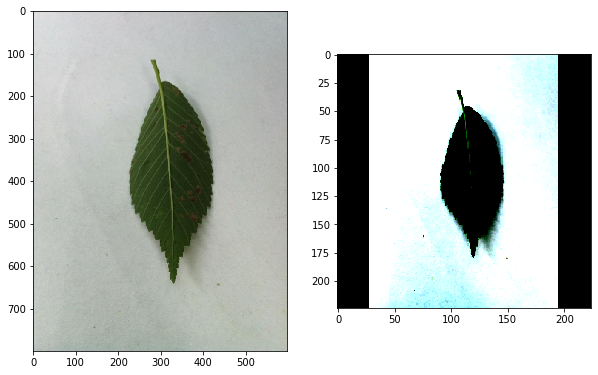

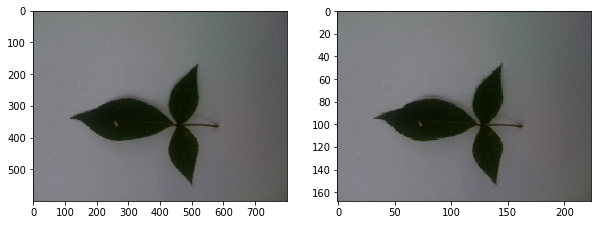

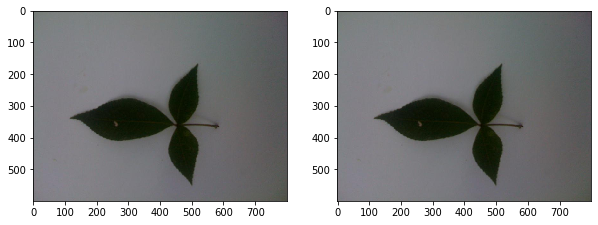

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


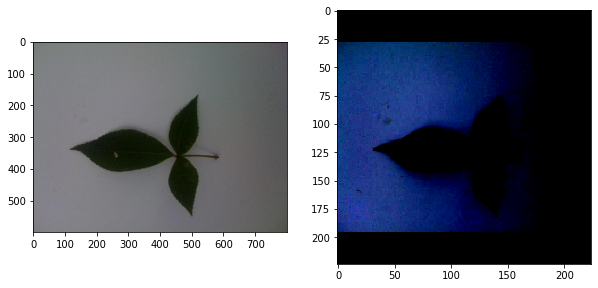

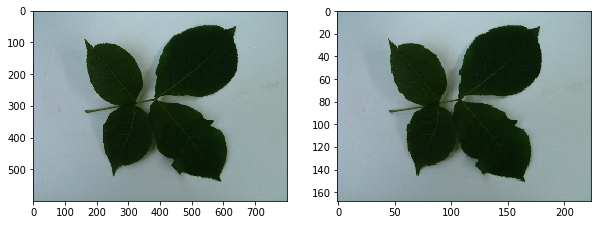

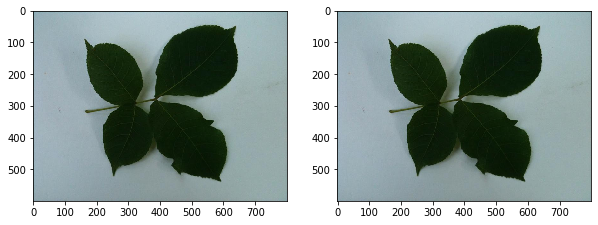

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


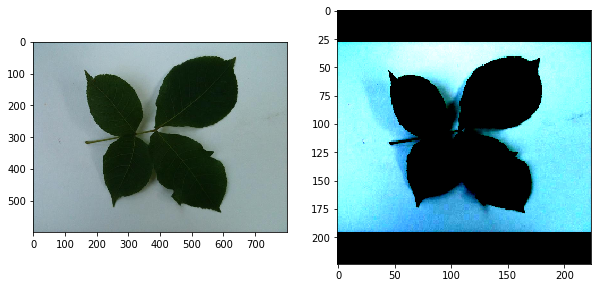

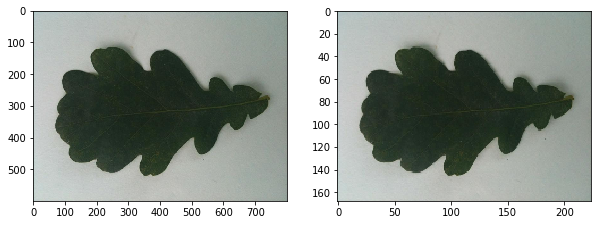

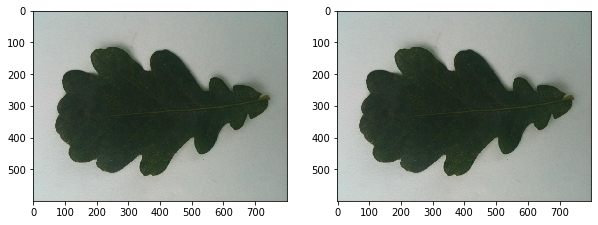

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


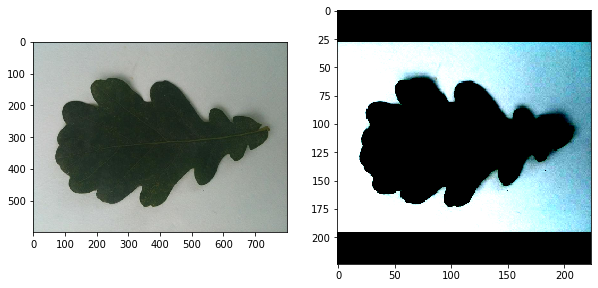

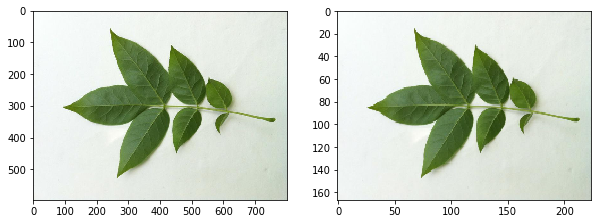

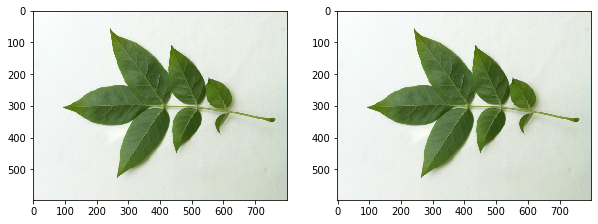

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


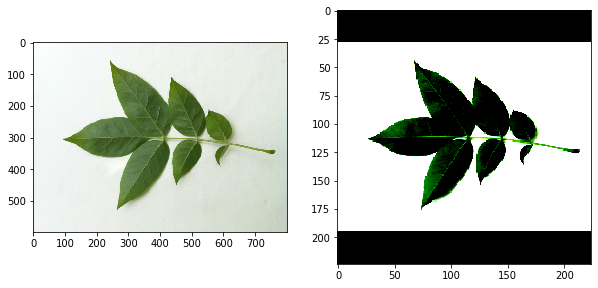

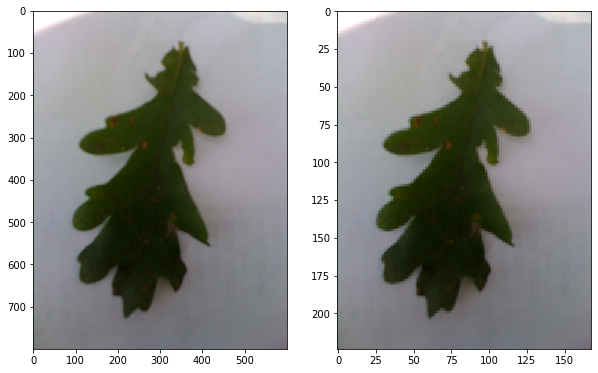

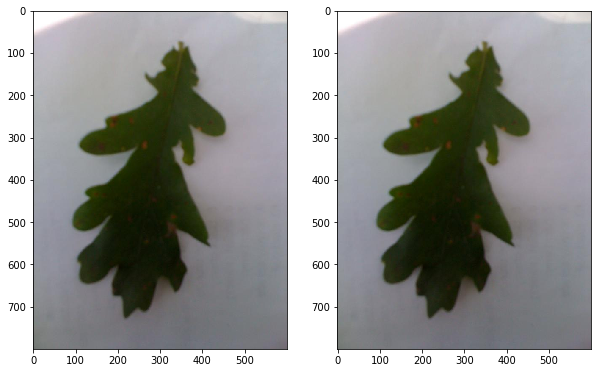

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


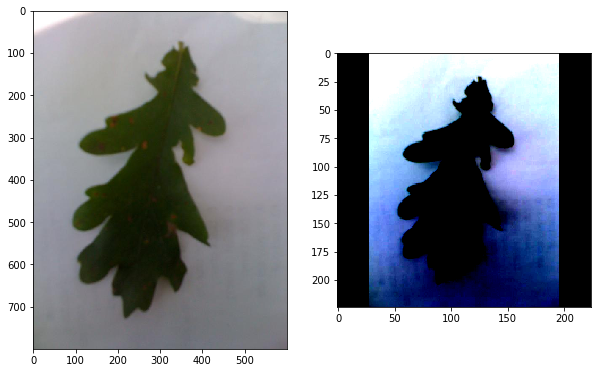

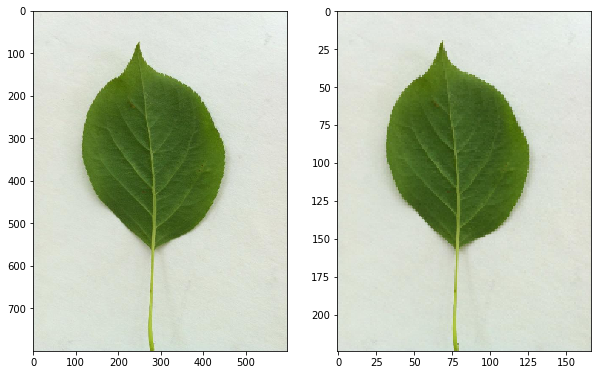

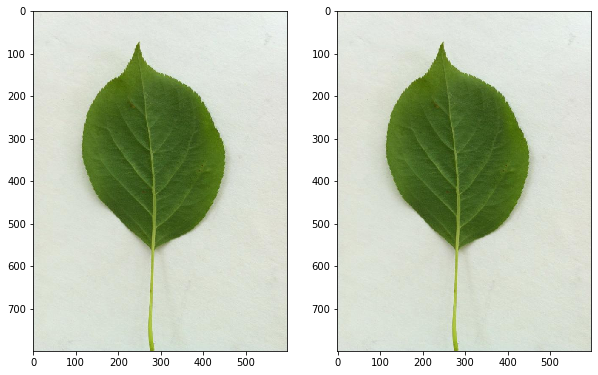

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


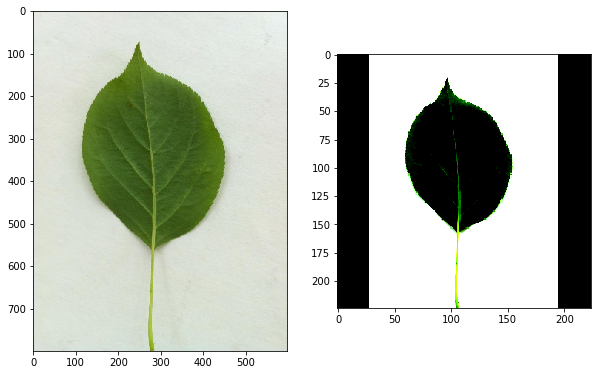

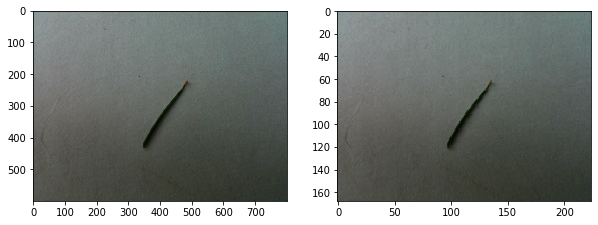

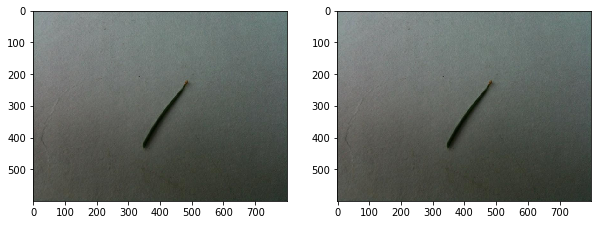

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


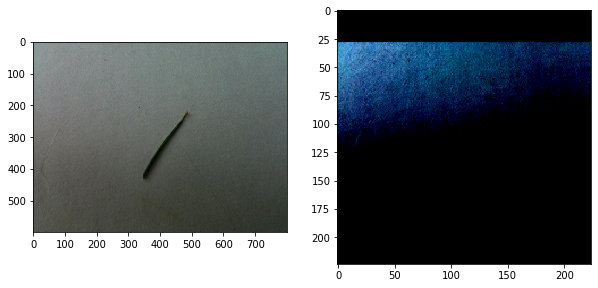

In [76]:
size = 224

def show_image_pair(image1, image2):
    fig = plt.figure(figsize=(10, 20))
    fig.add_subplot(1,2,1)
    plt.imshow(image1)
    fig.add_subplot(1,2, 2)
    plt.imshow(image2)
    plt.show()

def test_dataset(idx=0):

    dataset = Dataset(train, size)

    image1 = cv2.imread(dataset.df.iloc[idx].path)
    image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

    tensor = dataset[idx]
    image2 = np.transpose(tensor.numpy(), (1,2,0))

    show_image_pair(image1, image2)

for idx in range(100):
    test_dataset(idx)

In [69]:
#densenet model with features layer
model_name = 'densenet121'
layer_name = 'features'

#resnet model with average pool layer
# model_name = 'resnet18'
# layer_name = 'avgpool'

get_model = getattr(torchvision.models, model_name)

def extract_features(datf):

    model = get_model(pretrained=True)
    model = model.cuda()
    model.eval()

    # register hook to access to features in forward pass
    features = []
    def hook(module, input, output):
        N,C,H,W = output.shape
        output = output.reshape(N,C,-1)
        features.append(output.mean(dim=2).cpu().detach().numpy())
    handle = model._modules.get(layer_name).register_forward_hook(hook)

    dataset = Dataset(datf, size)
    loader = torch.utils.data.DataLoader(dataset, batch_size=8, shuffle=False, num_workers=0)

    for i_batch, inputs in tqdm(enumerate(loader), total=len(loader)):
        _ = model(inputs.cuda())

    features = np.concatenate(features)

    features = pd.DataFrame(features)
    features = features.add_prefix('PIXEL_')
    features.loc[:,'label'] = datf['label']
    features.loc[:,'path'] = datf['path']
 
    
    
    handle.remove()
    del model

    return features


In [70]:
features_train = extract_features(train)
features_test = extract_features(test)

In [71]:
features_train

,PIXEL_0,PIXEL_1,PIXEL_2,PIXEL_3,PIXEL_4,PIXEL_5,PIXEL_6,PIXEL_7,PIXEL_8,PIXEL_9,...,PIXEL_1016,PIXEL_1017,PIXEL_1018,PIXEL_1019,PIXEL_1020,PIXEL_1021,PIXEL_1022,PIXEL_1023,label,path
0,0.000188,0.000292,0.000245,0.002433,-0.074630,0.307885,0.000175,0.003293,-0.209523,-0.000128,...,-0.760934,0.381217,5.812289,1.081969,-0.365033,2.059042,1.185510,-1.342937,cryptomeria_japonica,C:/Users/Varadharajan R/Desktop/FYP/Dataset\cr...
1,0.000439,0.005047,0.000719,0.002041,-0.020146,0.229125,0.000218,0.000838,-0.399711,-0.000123,...,-0.546108,-0.400703,1.878046,1.359263,-1.000352,1.545793,-0.417862,-0.984130,quercus_stellata,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...
2,-0.000234,-0.000705,0.001113,0.001607,-0.130922,0.080967,-0.000235,0.001429,-0.267387,-0.000233,...,-0.850362,-1.501210,1.999808,1.159489,-1.136013,2.537091,0.351911,-0.683617,quercus_velutina,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...
3,0.000269,0.001714,0.001293,0.002900,-0.180888,0.433593,0.000942,0.001107,-0.158369,0.000316,...,-0.889209,-0.482970,0.994560,-0.180716,-1.202825,4.224101,-0.026610,-1.034068,syringa_reticulata,C:/Users/Varadharajan R/Desktop/FYP/Dataset\sy...
4,-0.000084,-0.002708,0.000006,0.002249,-0.153360,0.678686,0.000362,0.004179,-0.370848,-0.000164,...,-0.816349,0.381303,1.163959,2.609403,0.225463,2.320175,0.249518,-1.012798,pinus_strobus,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pi...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6170,-0.000474,0.001725,-0.000797,0.001098,-0.181235,0.304228,0.000133,0.003460,-0.183072,0.000050,...,-0.758796,-0.489330,7.270998,1.581089,-0.282909,1.182454,0.321179,-0.963147,gleditsia_triacanthos,C:/Users/Varadharajan R/Desktop/FYP/Dataset\gl...
6171,-0.000031,0.001846,0.000235,0.001588,-0.172408,-0.115818,-0.000280,-0.000358,-0.281596,-0.000250,...,-0.433639,-1.839707,-0.607840,1.604337,-0.993376,2.548183,-0.486796,-1.275880,prunus_sargentii,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pr...
6172,-0.000043,0.000802,-0.000631,0.000239,-0.123384,-0.143313,-0.000108,0.002152,-0.062947,0.000092,...,-0.544577,-1.130791,2.729697,-0.473934,-0.679647,3.254306,-0.052232,-0.717339,quercus_macrocarpa,C:/Users/Varadharajan R/Desktop/FYP/Dataset\qu...
6173,0.000143,-0.004141,0.000634,0.002529,-0.187943,1.276994,0.000663,0.001721,-0.127095,0.000090,...,-0.563584,0.556544,2.279351,1.513347,0.497928,1.586656,0.913159,-0.664608,pinus_cembra,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pi...


In [72]:
features_test

,PIXEL_0,PIXEL_1,PIXEL_2,PIXEL_3,PIXEL_4,PIXEL_5,PIXEL_6,PIXEL_7,PIXEL_8,PIXEL_9,...,PIXEL_1016,PIXEL_1017,PIXEL_1018,PIXEL_1019,PIXEL_1020,PIXEL_1021,PIXEL_1022,PIXEL_1023,label,path
0,0.000195,0.000296,0.000092,0.002043,-0.104041,0.271640,0.000422,0.000930,-0.172744,-0.000047,...,-1.086333,-0.936167,-0.903592,0.188517,-0.597081,2.003803,0.099260,-1.324397,stewartia_pseudocamellia,C:/Users/Varadharajan R/Desktop/FYP/Dataset\st...
1,0.000141,0.001151,0.002859,0.002327,-0.118339,0.600488,0.000303,0.003339,-0.317083,-0.000045,...,-1.310424,-1.136417,3.296470,0.009270,-0.927827,3.897306,0.026950,-0.682095,acer_palmatum,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ac...
2,-0.000074,-0.002049,0.000742,0.002258,-0.177386,0.457557,0.000118,0.002343,-0.224239,0.000261,...,-1.431841,0.085274,1.798664,0.119959,-1.567480,7.007920,0.129637,-0.656026,crataegus_viridis,C:/Users/Varadharajan R/Desktop/FYP/Dataset\cr...
3,0.000078,0.000465,0.000277,0.001351,-0.167814,0.025384,0.000181,0.001517,-0.295620,0.000022,...,-0.731536,-0.834544,-0.122712,-0.609415,-1.277888,3.529471,-0.508116,0.364909,populus_tremuloides,C:/Users/Varadharajan R/Desktop/FYP/Dataset\po...
4,0.000149,0.002608,0.002008,0.002473,-0.158427,-0.399118,0.000047,0.004309,-0.342264,-0.000303,...,0.009386,-0.722199,-0.850774,0.436617,-0.448221,1.460126,-0.285133,-0.664981,catalpa_speciosa,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ca...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1539,-0.000031,0.001846,0.000235,0.001588,-0.172408,-0.115818,-0.000280,-0.000358,-0.281596,-0.000250,...,-0.433639,-1.839707,-0.607840,1.604337,-0.993376,2.548183,-0.486796,-1.275880,prunus_sargentii,C:/Users/Varadharajan R/Desktop/FYP/Dataset\pr...
1540,0.000255,0.004619,0.003251,0.001711,-0.169073,-0.258934,0.000294,0.002115,-0.282909,-0.000013,...,-0.726324,-1.588354,0.922283,-0.155276,-0.716598,1.851860,-0.315307,-0.569810,catalpa_speciosa,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ca...
1541,-0.000071,0.000912,-0.001108,0.000581,-0.181093,0.111765,0.000287,0.002753,-0.224047,0.000005,...,-0.675642,-1.706228,0.053264,0.504806,-0.500700,2.545757,0.132625,-1.369961,aesculus_pavi,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ae...
1542,0.000277,-0.001736,0.003169,0.003639,-0.101283,0.274500,0.000140,0.004739,-0.230631,0.000218,...,-0.952701,-0.005134,3.266346,1.916081,-0.700799,5.038589,0.702823,-1.394805,tsuga_canadensis,C:/Users/Varadharajan R/Desktop/FYP/Dataset\ts...


In [73]:
#train and test image features converted to csv
features_train.to_csv('%s_size%d_train.csv' % (model_name, size), index=False)
features_test.to_csv('%s_size%d_test.csv' % (model_name, size), index=False)